In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
import os

In [4]:
activity_codes_mapping = {'A': 'walking',
                          'B': 'jogging',
                          'C': 'stairs',
                          'D': 'sitting',
                          'E': 'standing',
                          'F': 'typing',
                          'G': 'brushing teeth',
                          'H': 'eating soup',
                          'I': 'eating chips',
                          'J': 'eating pasta',
                          'K': 'drinking from cup',
                          'L': 'eating sandwich',
                          'M': 'kicking soccer ball',
                          'O': 'playing catch tennis ball',
                          'P': 'dribbling basket ball',
                          'Q': 'writing',
                          'R': 'clapping',
                          'S': 'folding clothes'}

activity_color_map = {activity_codes_mapping['A']: 'lime',
                      activity_codes_mapping['B']: 'red',
                      activity_codes_mapping['C']: 'blue',
                      activity_codes_mapping['D']: 'orange',
                      activity_codes_mapping['E']: 'yellow',
                      activity_codes_mapping['F']: 'lightgreen',
                      activity_codes_mapping['G']: 'greenyellow',
                      activity_codes_mapping['H']: 'magenta',
                      activity_codes_mapping['I']: 'gold',
                      activity_codes_mapping['J']: 'cyan',
                      activity_codes_mapping['K']: 'purple',
                      activity_codes_mapping['L']: 'lightgreen',
                      activity_codes_mapping['M']: 'violet',
                      activity_codes_mapping['O']: 'limegreen',
                      activity_codes_mapping['P']: 'deepskyblue',   
                      activity_codes_mapping['Q']: 'mediumspringgreen',
                      activity_codes_mapping['R']: 'plum',
                      activity_codes_mapping['S']: 'olive'}

In [5]:
def show_accel_per_activity(device, df, act, interval_in_sec = None):
  ''' Plots acceleration time history per activity '''

  df1 = df.loc[df.activity == act].copy()
  df1.reset_index(drop = True, inplace = True)

  df1['duration'] = (df1['timestamp'] - df1['timestamp'].iloc[0])/1000000000 # nanoseconds --> seconds

  if interval_in_sec == None:
    ax = df1[:].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) # ,title = act)
  else:
    ax = df1[:interval_in_sec*20].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) # ,title = act)

  ax.set_xlabel('duration  (sec)', fontsize = 15)
  ax.set_ylabel('acceleration  (m/sec^2)',fontsize = 15)
  ax.set_title('Acceleration:   Device: ' + device + '      Activity:  ' + act, fontsize = 15)

In [6]:
def show_ang_velocity_per_activity(device, df, act, interval_in_sec = None):
  ''' Plots angular volocity time history per activity '''

  df1 = df.loc[df.activity == act].copy()
  df1.reset_index(drop = True, inplace = True)

  df1['duration'] = (df1['timestamp'] - df1['timestamp'].iloc[0])/1000000000 # nanoseconds --> seconds

  if interval_in_sec == None:
    ax = df1[:].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) # ,title = act)
  else:
    ax = df1[:interval_in_sec*20].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) # ,title = act)

  ax.set_xlabel('duration  (sec)', fontsize = 15)
  ax.set_ylabel('angular velocity  (rad/sec)',fontsize = 15)
  ax.set_title('Angular velocity:  Device: ' + device + '      Activity:  ' + act, fontsize = 15)

In [7]:
raw_par_10_phone_accel = pd.read_csv(r'DATA/phone/accel/data_1610_accel_phone.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_10_phone_accel.z = raw_par_10_phone_accel.z.str.strip(';')
raw_par_10_phone_accel.z = pd.to_numeric(raw_par_10_phone_accel.z)

raw_par_10_phone_accel['activity'] = raw_par_10_phone_accel['activity_code'].map(activity_codes_mapping)

raw_par_10_phone_accel = raw_par_10_phone_accel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_10_phone_accel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1610,A,walking,18687441561967,1.174957,13.347473,-4.034637
1,1610,A,walking,18687491915971,1.408188,7.091858,-3.895721
2,1610,A,walking,18687542269974,4.932510,6.306808,-2.339005
3,1610,A,walking,18687592623978,0.154648,6.123505,-1.831467
4,1610,A,walking,18687642977982,-2.826035,4.180542,-3.211899
...,...,...,...,...,...,...,...
80865,1610,S,folding clothes,17989031516129,5.946732,7.583008,-1.097260
80866,1610,S,folding clothes,17989081870133,5.818741,7.804871,-1.623733
80867,1610,S,folding clothes,17989132224137,5.530823,7.636093,-1.662643
80868,1610,S,folding clothes,17989182578141,5.802170,7.645752,-1.000412


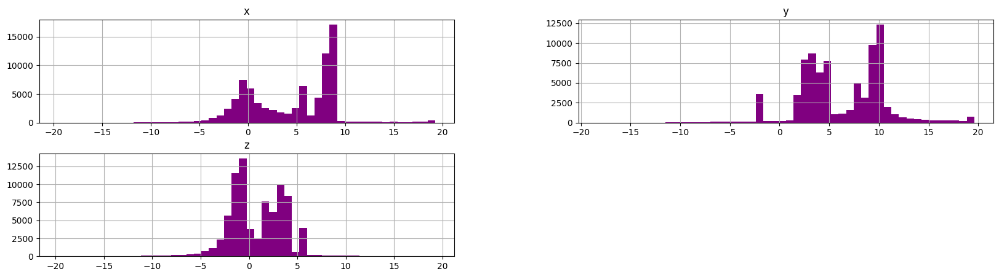

In [8]:
#T = raw_par_10_phone_accel.iloc[:200]
T = raw_par_10_phone_accel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='purple')
#T.hist(column='x', by='activity')

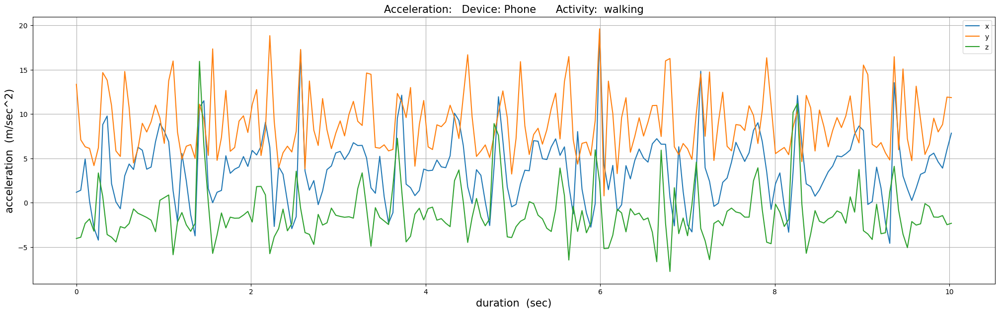

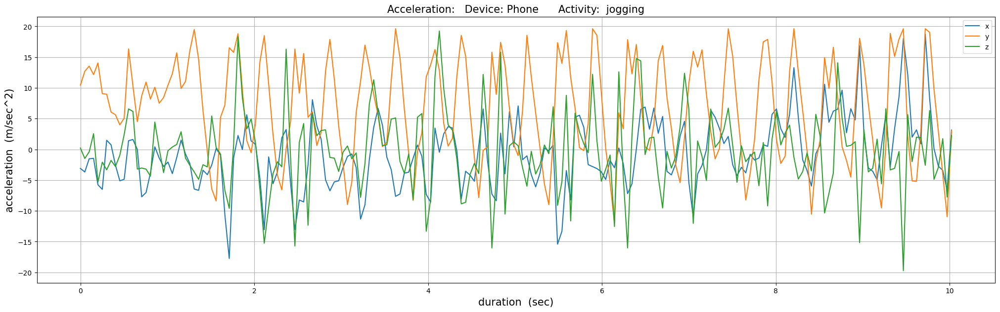

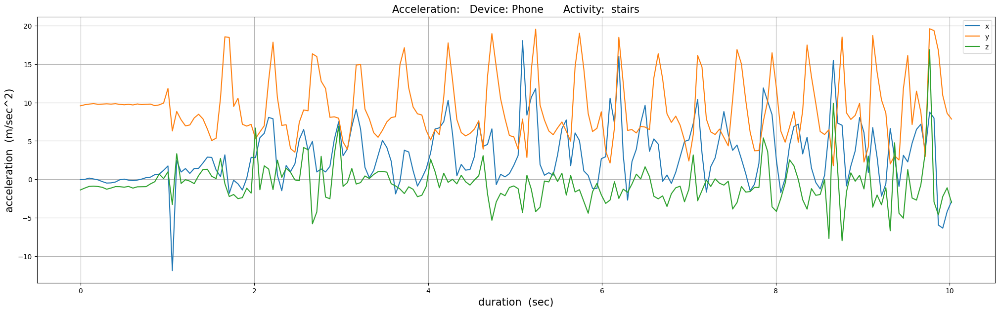

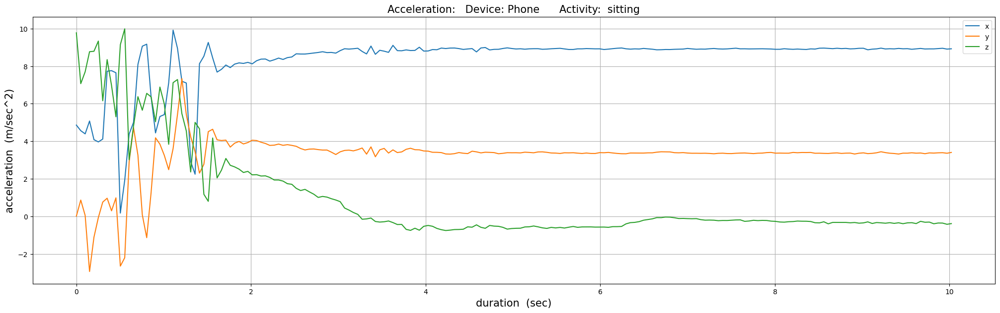

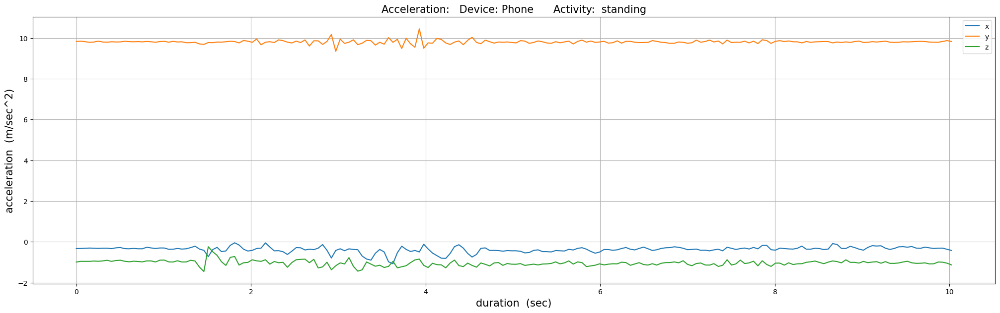

...

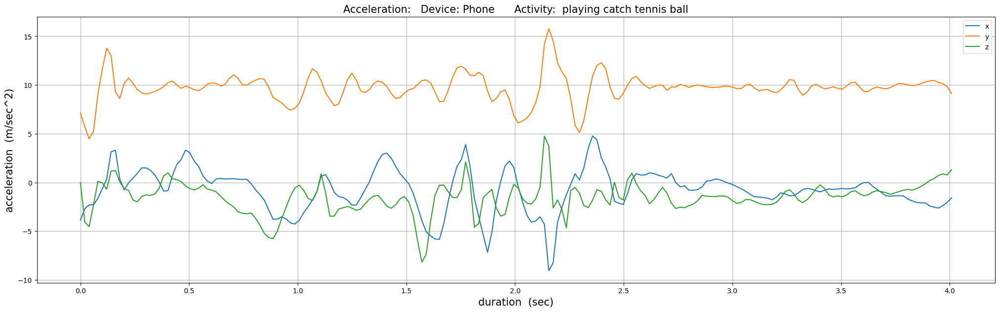

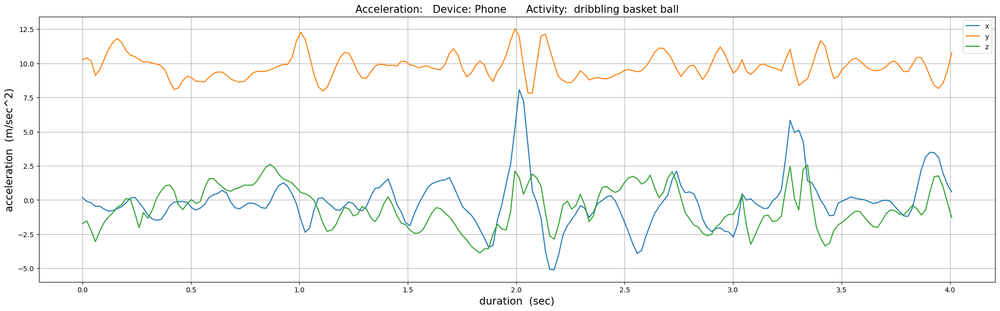

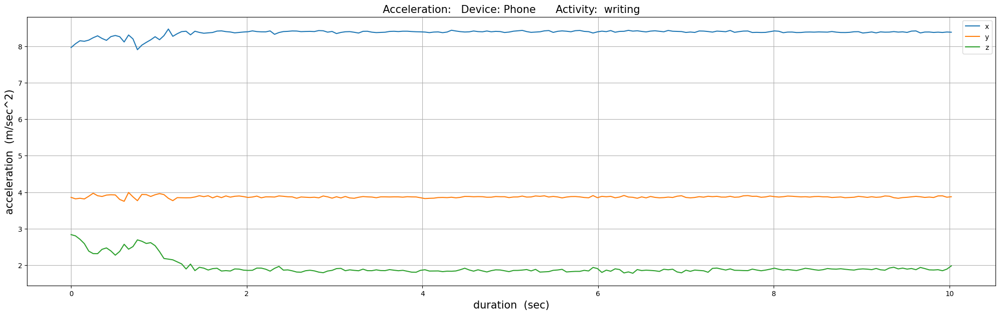

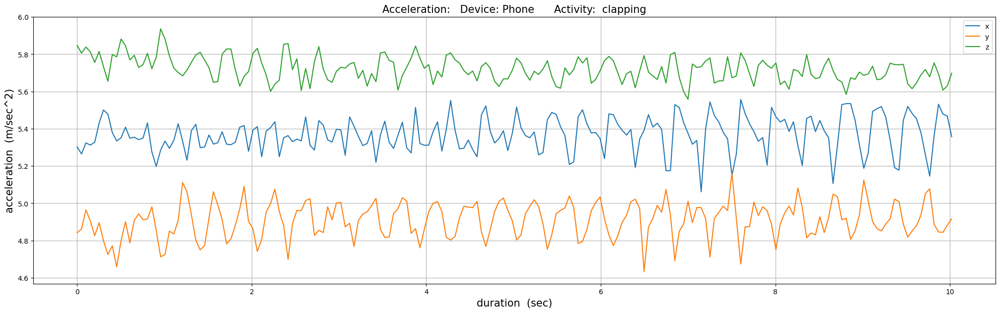

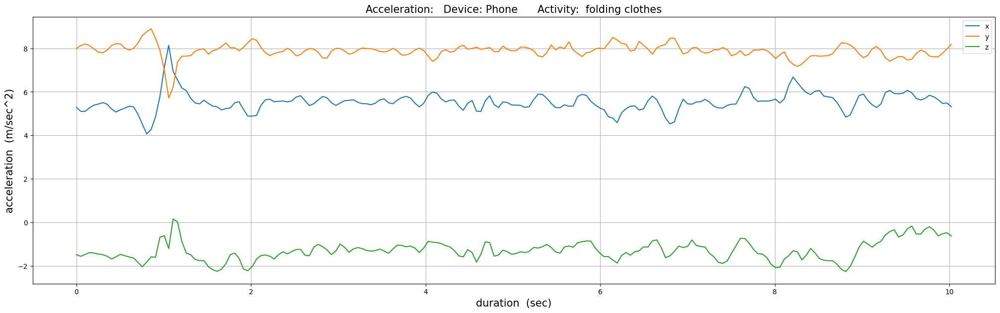

In [9]:
for key in activity_codes_mapping:
  show_accel_per_activity('Phone', raw_par_10_phone_accel, activity_codes_mapping[key], 10)

In [10]:
raw_par_20_watch_accel = pd.read_csv(r'DATA/watch/accel/data_1620_accel_watch.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_20_watch_accel.z = raw_par_20_watch_accel.z.str.strip(';')
raw_par_20_watch_accel.z = pd.to_numeric(raw_par_20_watch_accel.z)

raw_par_20_watch_accel['activity'] = raw_par_20_watch_accel['activity_code'].map(activity_codes_mapping)

raw_par_20_watch_accel = raw_par_20_watch_accel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_20_watch_accel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1620,A,walking,37945621841814,3.417424,-2.164957,-4.849306
1,1620,A,walking,37945671341814,5.423765,-6.936601,-4.954651
2,1620,A,walking,37945720841814,4.700716,-3.127426,-7.648128
3,1620,A,walking,37945770341814,8.033444,-4.700417,-5.024083
4,1620,A,walking,37945819841814,3.970484,-1.645415,-3.621080
...,...,...,...,...,...,...,...
67189,1620,S,folding clothes,42368439960621,6.524798,-4.589834,0.573262
67190,1620,S,folding clothes,42368489889911,9.100959,-4.168455,-0.602291
67191,1620,S,folding clothes,42368539819201,7.590218,-5.736657,-1.854459
67192,1620,S,folding clothes,42368589748491,8.681973,-6.284929,-5.180005


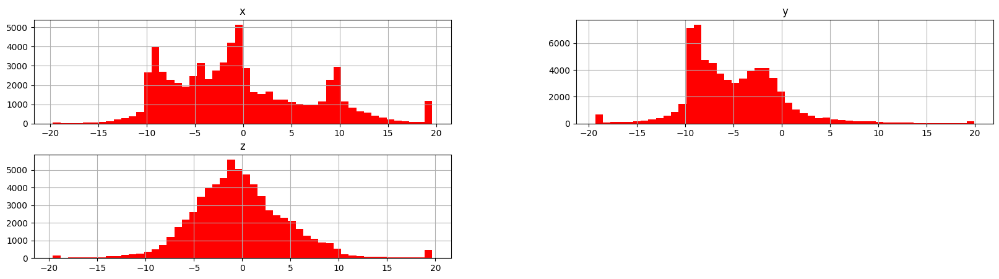

In [11]:
T = raw_par_20_watch_accel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='red')

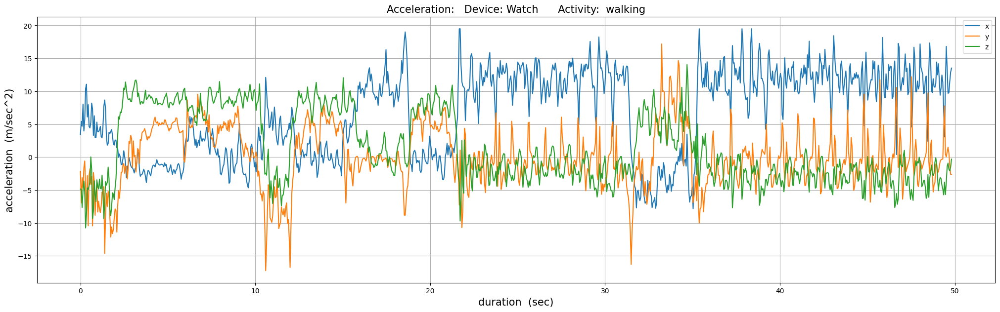

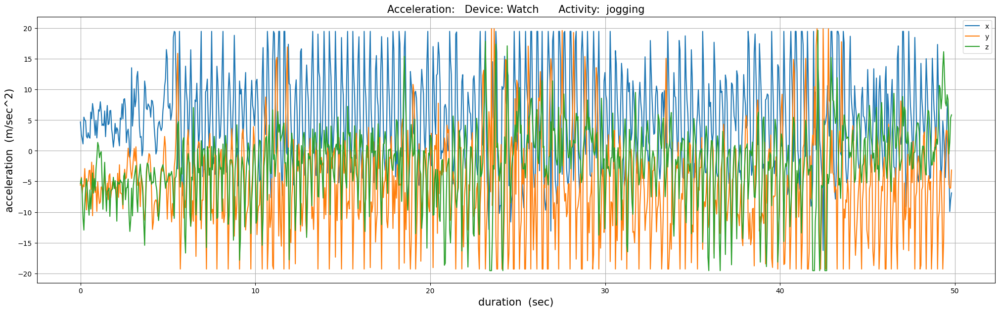

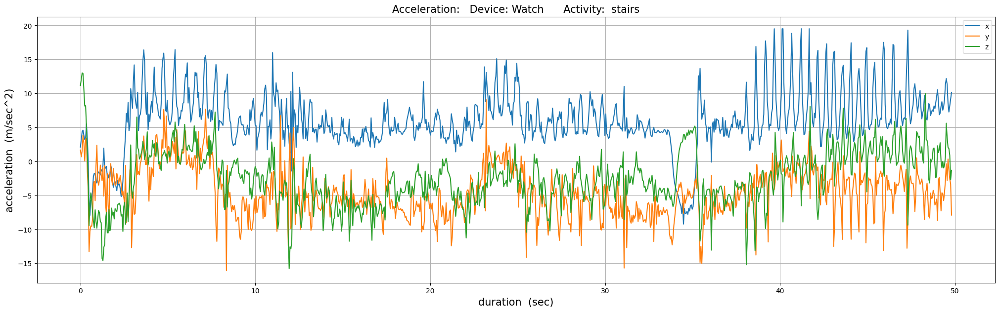

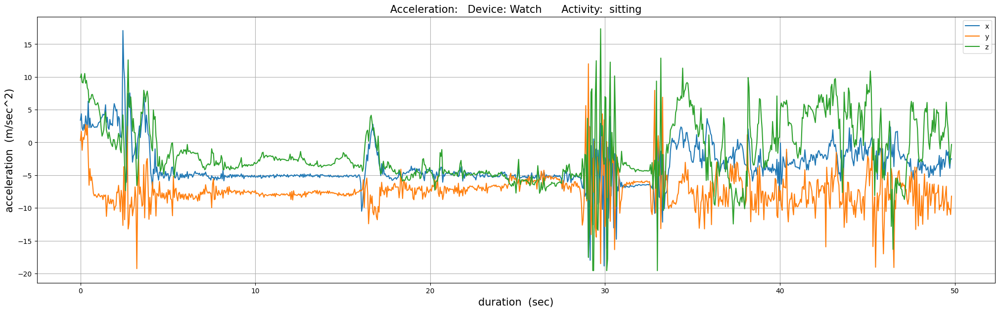

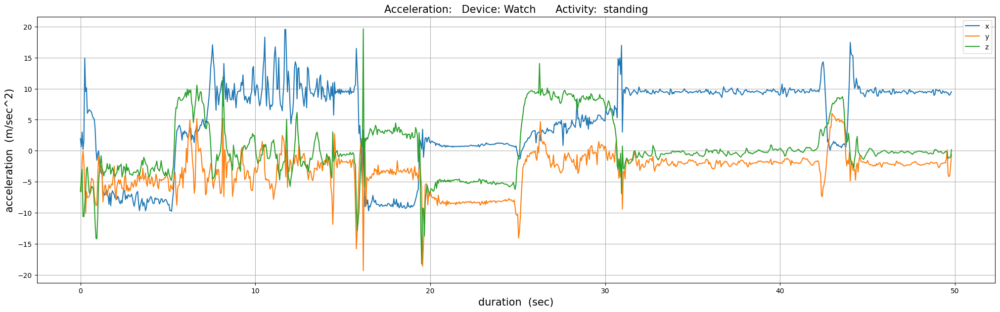

...

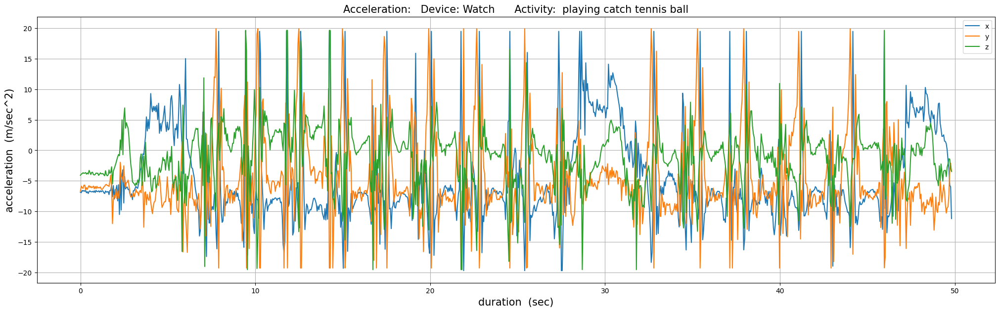

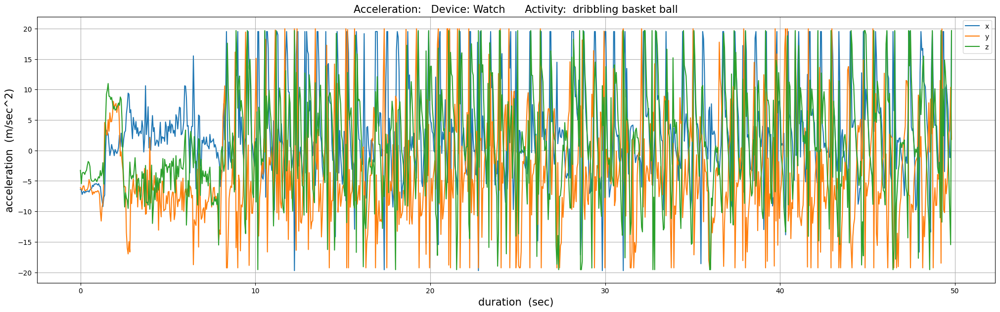

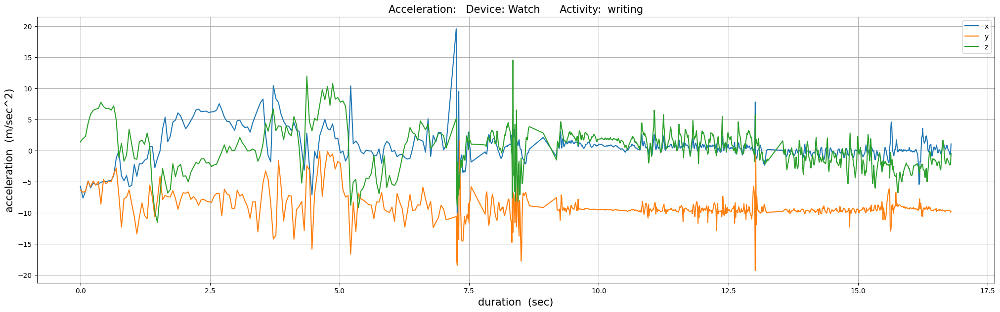

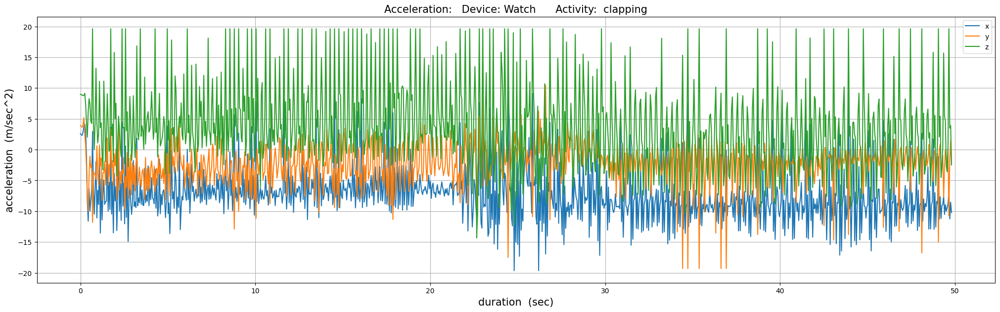

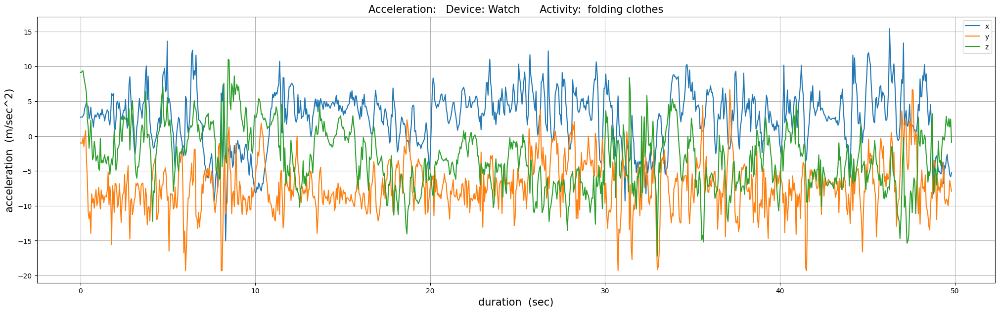

In [12]:
for key in activity_codes_mapping:
  show_accel_per_activity('Watch', raw_par_20_watch_accel, activity_codes_mapping[key], 50)

In [13]:
raw_par_35_phone_ang_vel = pd.read_csv(r'DATA/phone/gyro/data_1635_gyro_phone.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_35_phone_ang_vel.z = raw_par_35_phone_ang_vel.z.str.strip(';')
raw_par_35_phone_ang_vel.z = pd.to_numeric(raw_par_35_phone_ang_vel.z)

raw_par_35_phone_ang_vel['activity'] = raw_par_35_phone_ang_vel['activity_code'].map(activity_codes_mapping)

raw_par_35_phone_ang_vel = raw_par_35_phone_ang_vel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_35_phone_ang_vel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1635,A,walking,676165107876419,0.874725,-0.098099,0.807510
1,1635,A,walking,676165158230423,0.563431,-1.359665,1.432419
2,1635,A,walking,676165208584427,1.507690,-3.086883,0.679016
3,1635,A,walking,676165258938431,1.430603,-1.860306,0.451035
4,1635,A,walking,676165309292435,0.325165,-1.735611,0.252365
...,...,...,...,...,...,...,...
64530,1635,S,folding clothes,680277872380268,-0.119614,-0.032928,0.129654
64531,1635,S,folding clothes,680277922750286,-0.500427,-0.465652,0.098923
64532,1635,S,folding clothes,680277973104290,-0.768646,-0.448929,0.063583
64533,1635,S,folding clothes,680278023458294,-0.786408,-0.346924,0.099899


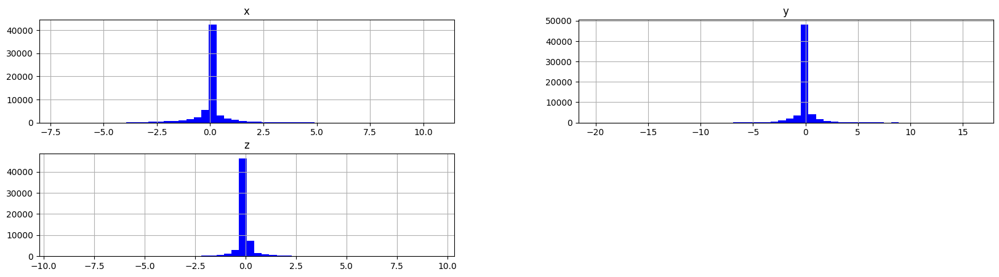

In [14]:
T = raw_par_35_phone_ang_vel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='blue')

In [15]:
raw_par_45_watch_ang_vel = pd.read_csv(r'DATA/watch/gyro/data_1635_gyro_watch.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_45_watch_ang_vel.z = raw_par_45_watch_ang_vel.z.str.strip(';')
raw_par_45_watch_ang_vel.z = pd.to_numeric(raw_par_45_watch_ang_vel.z)

raw_par_45_watch_ang_vel['activity'] = raw_par_45_watch_ang_vel['activity_code'].map(activity_codes_mapping)

raw_par_45_watch_ang_vel = raw_par_45_watch_ang_vel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_45_watch_ang_vel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1635,A,walking,64768437041043,0.117911,-0.145542,-1.300821
1,1635,A,walking,64768486541043,1.038300,-0.455534,-1.134640
2,1635,A,walking,64768536041043,0.876380,-0.541820,-0.844888
3,1635,A,walking,64768585541043,0.912599,-0.388422,-0.394281
4,1635,A,walking,64768635041043,0.048669,-0.046472,0.288554
...,...,...,...,...,...,...,...
64853,1635,S,folding clothes,68881084984774,-0.426159,0.298781,2.808190
64854,1635,S,folding clothes,68881134912344,1.008752,-0.439448,2.320299
64855,1635,S,folding clothes,68881184839914,0.938445,-0.437317,1.726947
64856,1635,S,folding clothes,68881234767484,1.552037,-0.296702,1.282731


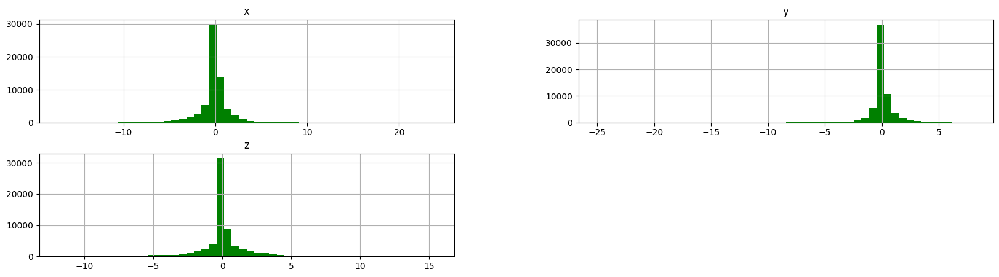

In [16]:
T = raw_par_45_watch_ang_vel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='green')

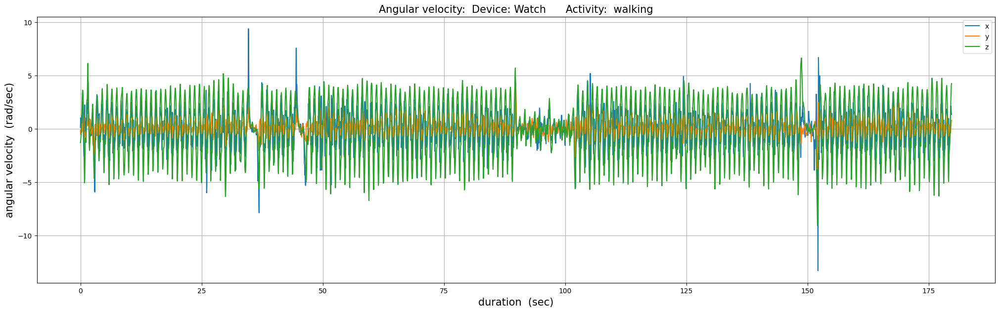

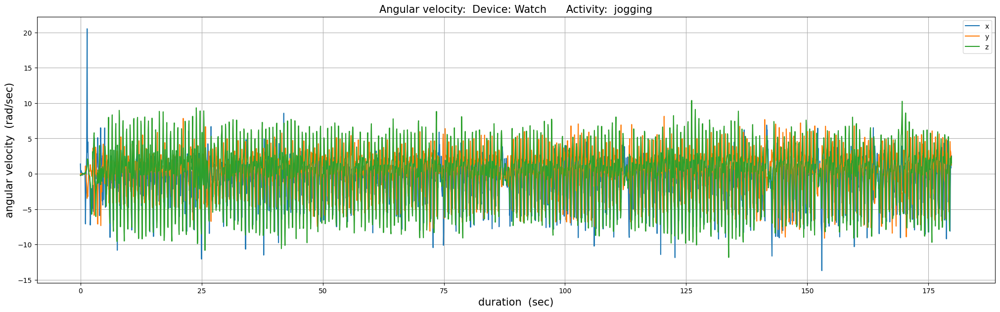

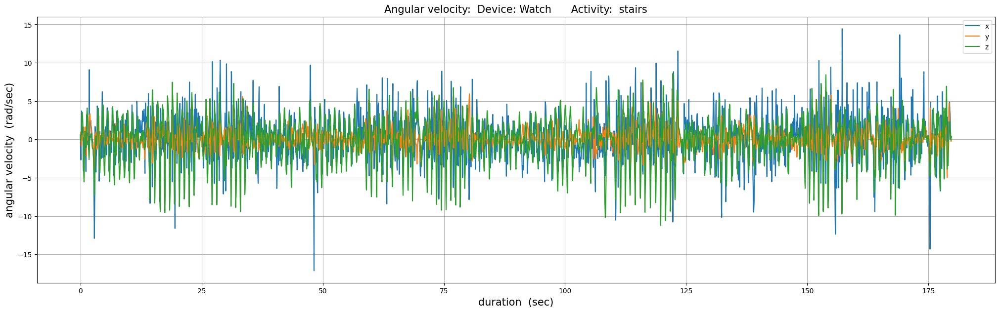

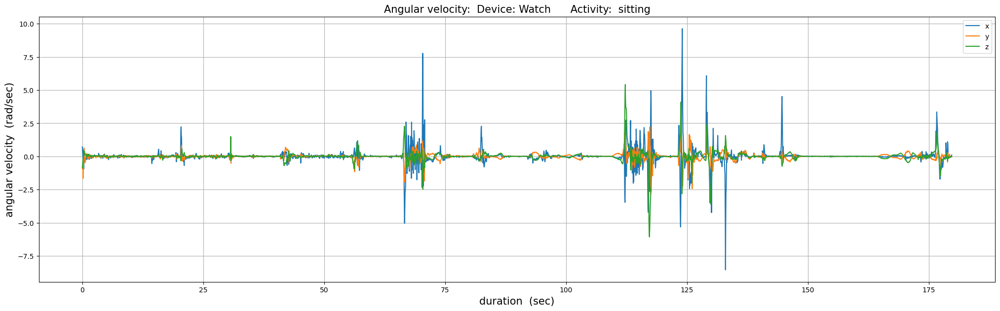

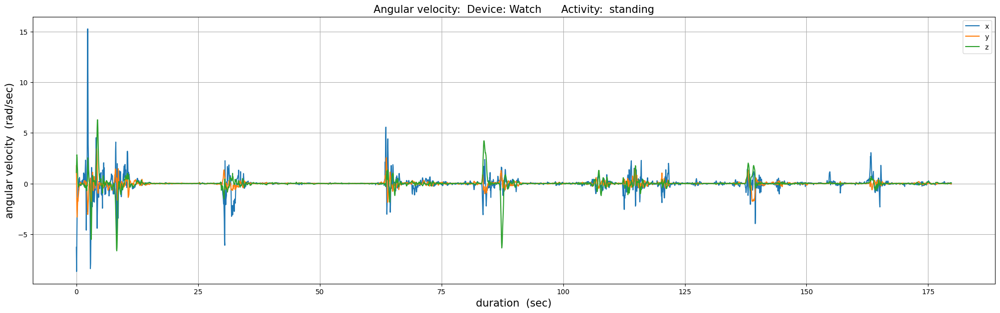

...

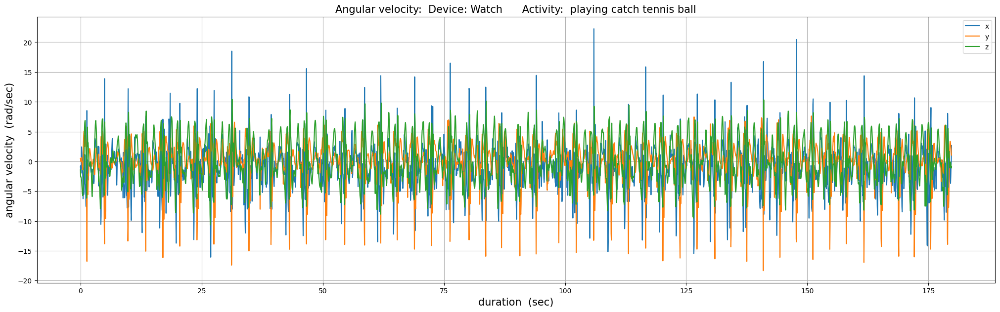

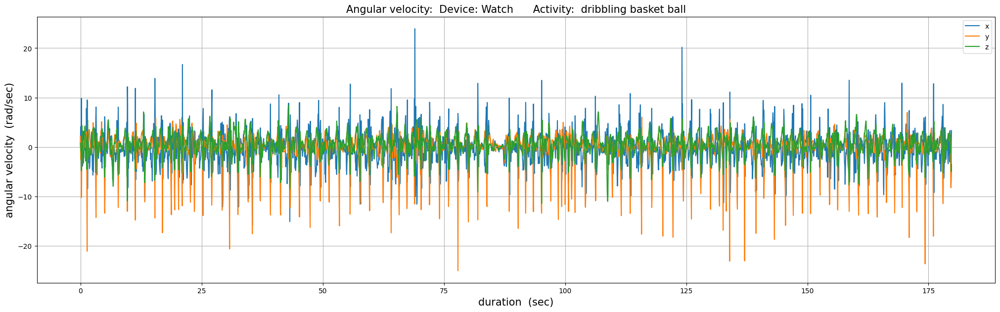

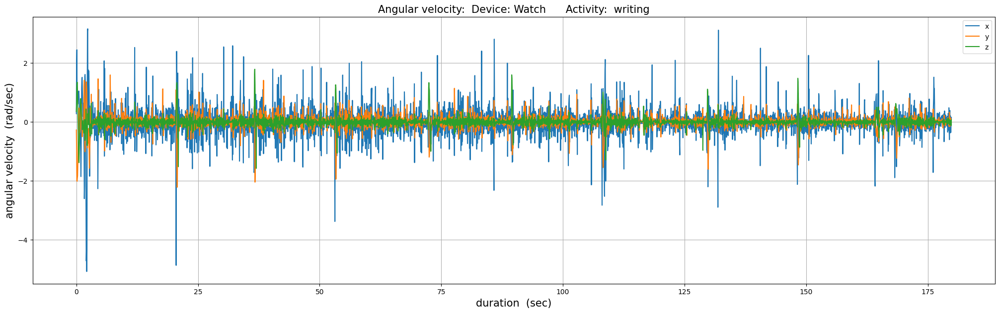

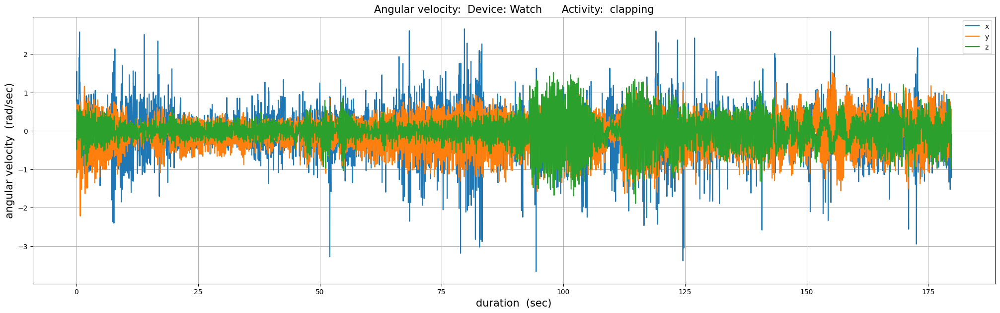

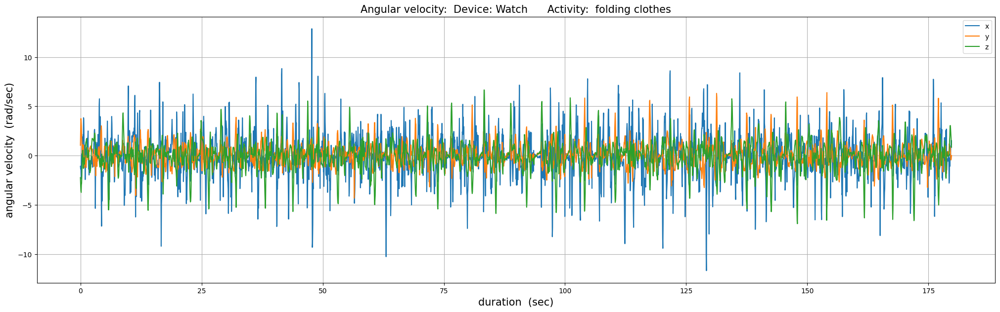

In [17]:
for key in activity_codes_mapping:
  show_ang_velocity_per_activity('Watch', raw_par_45_watch_ang_vel, activity_codes_mapping[key])


In [18]:
features = ['ACTIVITY',
            'X0', # 1st bin fraction of x axis acceleration distribution
            'X1', # 2nd bin fraction ...
            'X2',
            'X3',
            'X4',
            'X5',
            'X6',
            'X7',
            'X8',
            'X9',
            'Y0', # 1st bin fraction of y axis acceleration distribution
            'Y1', # 2nd bin fraction ...
            'Y2',
            'Y3',
            'Y4',
            'Y5',
            'Y6',
            'Y7',
            'Y8',
            'Y9',
            'Z0', # 1st bin fraction of z axis acceleration distribution
            'Z1', # 2nd bin fraction ...
            'Z2',
            'Z3',
            'Z4',
            'Z5',
            'Z6',
            'Z7',
            'Z8',
            'Z9',
            'XAVG', # average sensor value over the window (per axis)
            'YAVG',
            'ZAVG',
            'XPEAK', # Time in milliseconds between the peaks in the wave associated with most activities. heuristically determined (per axis)
            'YPEAK',
            'ZPEAK',
            'XABSOLDEV', # Average absolute difference between the each of the 200 readings and the mean of those values (per axis)
            'YABSOLDEV',
            'ZABSOLDEV',
            'XSTANDDEV', # Standard deviation of the 200 window's values (per axis)  ***BUG!***
            'YSTANDDEV',
            'ZSTANDDEV',
            'XVAR', # Variance of the 200 window's values (per axis)   ***BUG!***
            'YVAR',
            'ZVAR',
            'XMFCC0', # short-term power spectrum of a wave, based on a linear cosine transform of a log power spectrum on a non-linear mel scale of frequency (13 values per axis)
            'XMFCC1',
            'XMFCC2',
            'XMFCC3',
            'XMFCC4',
            'XMFCC5',
            'XMFCC6',
            'XMFCC7',
            'XMFCC8',
            'XMFCC9',
            'XMFCC10',
            'XMFCC11',
            'XMFCC12',
            'YMFCC0', # short-term power spectrum of a wave, based on a linear cosine transform of a log power spectrum on a non-linear mel scale of frequency (13 values per axis)
            'YMFCC1',
            'YMFCC2',
            'YMFCC3',
            'YMFCC4',
            'YMFCC5',
            'YMFCC6',
            'YMFCC7',
            'YMFCC8',
            'YMFCC9',
            'YMFCC10',
            'YMFCC11',
            'YMFCC12',
            'ZMFCC0', # short-term power spectrum of a wave, based on a linear cosine transform of a log power spectrum on a non-linear mel scale of frequency (13 values per axis)
            'ZMFCC1',
            'ZMFCC2',
            'ZMFCC3',
            'ZMFCC4',
            'ZMFCC5',
            'ZMFCC6',
            'ZMFCC7',
            'ZMFCC8',
            'ZMFCC9',
            'ZMFCC10',
            'ZMFCC11',
            'ZMFCC12',
            'XYCOS', # The cosine distances between sensor values for pairs of axes (three pairs of axes)
            'XZCOS',
            'YZCOS',
            'XYCOR', # The correlation between sensor values for pairs of axes (three pairs of axes)
            'XZCOR',
            'YZCOR',
            'RESULTANT', # Average resultant value, computed by squaring each matching x, y, and z value, summing them, taking the square root, and then averaging these values over the 200 readings
            'PARTICIPANT'] # Categirical: 1600 -1650

len(features)

93

In [19]:
import glob

#the duplicate files to be ignored; all identical to 1600
duplicate_files = [str(i) for i in range(1611, 1618)] # '1611',...'1617'

path = r'DATA/signals/phone/accel'
all_files = glob.glob(path + "/*.arff")

list_dfs_phone_accel = []

for filename in all_files:

    if any(dup_fn in filename for dup_fn in duplicate_files):
        continue #ignore the duplicate files
    df = pd.read_csv(filename, names = features, skiprows = 96, index_col=None, header=0)
    list_dfs_phone_accel.append(df)

all_phone_accel = pd.concat(list_dfs_phone_accel, axis=0, ignore_index=True, sort=False)

all_phone_accel


,ACTIVITY,X0,X1,X2,X3,X4,X5,X6,X7,X8,...,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT,PARTICIPANT
0,A,0.235,0.470,0.275,0.020,0.000,0.0,0.0,0.0,0.0,...,0.486106,0.479859,-0.550668,0.049864,0.121354,-0.251024,0.164468,-0.110722,10.05180,1600
1,A,0.275,0.440,0.270,0.015,0.000,0.0,0.0,0.0,0.0,...,0.479571,0.473409,-0.633171,0.072129,0.161492,-0.386416,0.215680,-0.034375,10.11710,1600
2,A,0.320,0.430,0.245,0.000,0.005,0.0,0.0,0.0,0.0,...,0.483005,0.476798,-0.659493,0.087043,0.162157,-0.325151,0.272380,-0.077274,9.98384,1600
3,A,0.315,0.495,0.185,0.005,0.000,0.0,0.0,0.0,0.0,...,0.480711,0.474534,-0.712081,0.003810,0.210015,-0.364285,0.203131,0.015328,10.10600,1600
4,A,0.215,0.455,0.325,0.005,0.000,0.0,0.0,0.0,0.0,...,0.468836,0.462811,-0.534933,0.047553,0.275833,-0.216423,0.238500,-0.009870,10.05210,1600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20645,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.208123,0.205448,0.965885,-0.006364,-0.192099,-0.708716,0.720199,-0.651551,9.40653,1650
20646,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.247499,0.244319,0.965439,0.861812,0.919008,-0.792718,-0.641690,0.547467,9.41056,1650
20647,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.320125,0.316012,0.942726,0.542231,0.357909,-0.542299,0.309224,-0.571912,9.44613,1650
20648,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.276562,0.273008,0.932298,-0.270526,-0.518026,-0.797365,0.813487,-0.677182,9.44593,1650


In [20]:
all_phone_accel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20650 entries, 0 to 20649
Data columns (total 93 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   ACTIVITY     20650 non-null  object 
 1   X0           20650 non-null  float64
 2   X1           20650 non-null  float64
 3   X2           20650 non-null  float64
 4   X3           20650 non-null  float64
 5   X4           20650 non-null  float64
 6   X5           20650 non-null  float64
 7   X6           20650 non-null  float64
 8   X7           20650 non-null  float64
 9   X8           20650 non-null  float64
 10  X9           20650 non-null  float64
 11  Y0           20650 non-null  float64
 12  Y1           20650 non-null  float64
 13  Y2           20650 non-null  float64
 14  Y3           20650 non-null  float64
 15  Y4           20650 non-null  float64
 16  Y5           20650 non-null  float64
 17  Y6           20650 non-null  float64
 18  Y7           20650 non-null  float64
 19  Y8  

In [21]:
all_phone_accel_breakpoint = all_phone_accel.copy()

In [22]:
all_phone_accel['ACTIVITY'].map(activity_codes_mapping).value_counts()

ACTIVITY
drinking from cup            1202
kicking soccer ball          1196
jogging                      1194
standing                     1175
brushing teeth               1174
walking                      1169
clapping                     1162
playing catch tennis ball    1161
sitting                      1155
folding clothes              1153
dribbling basket ball        1149
eating soup                  1144
eating sandwich              1134
writing                      1133
eating chips                 1128
eating pasta                 1077
typing                       1072
stairs                       1072
Name: count, dtype: int64

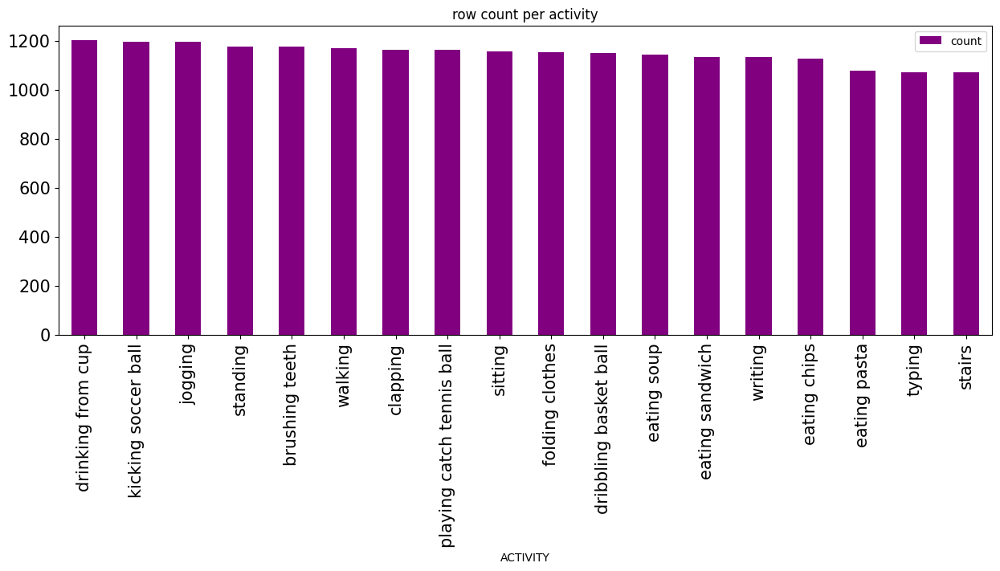

In [23]:
_ = all_phone_accel['ACTIVITY'].map(activity_codes_mapping).value_counts().plot(kind = 'bar', figsize = (15,5), color = 'purple', title = 'row count per activity', legend = True, fontsize = 15)

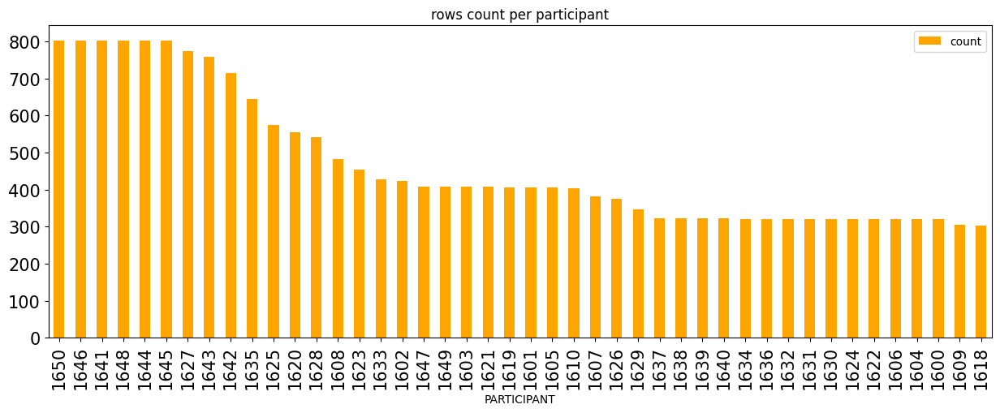

In [24]:
_ = all_phone_accel['PARTICIPANT'].value_counts().plot(kind = 'bar', figsize = (15,5), color = 'orange', title= 'rows count per participant', legend = True, fontsize = 15)

In [25]:
all_phone_accel[['XABSOLDEV', 'YABSOLDEV','ZABSOLDEV','XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR']].head()


,XABSOLDEV,YABSOLDEV,ZABSOLDEV,XSTANDDEV,YSTANDDEV,ZSTANDDEV,XVAR,YVAR,ZVAR
0,1.59095,3.29508,1.60941,0.141170,0.283329,0.159800,0.375726,0.532286,0.399750
1,1.77817,3.33490,1.68296,0.161229,0.287955,0.157993,0.401533,0.536614,0.397483
2,1.70505,3.14244,1.69288,0.156200,0.269307,0.159797,0.395221,0.518948,0.399746
3,1.62315,3.32790,1.57944,0.141721,0.283364,0.154396,0.376459,0.532320,0.392933
4,1.48888,3.01196,1.45931,0.131537,0.256423,0.140283,0.362681,0.506383,0.374544


In [26]:
all_phone_accel.drop(['XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1, inplace = True)

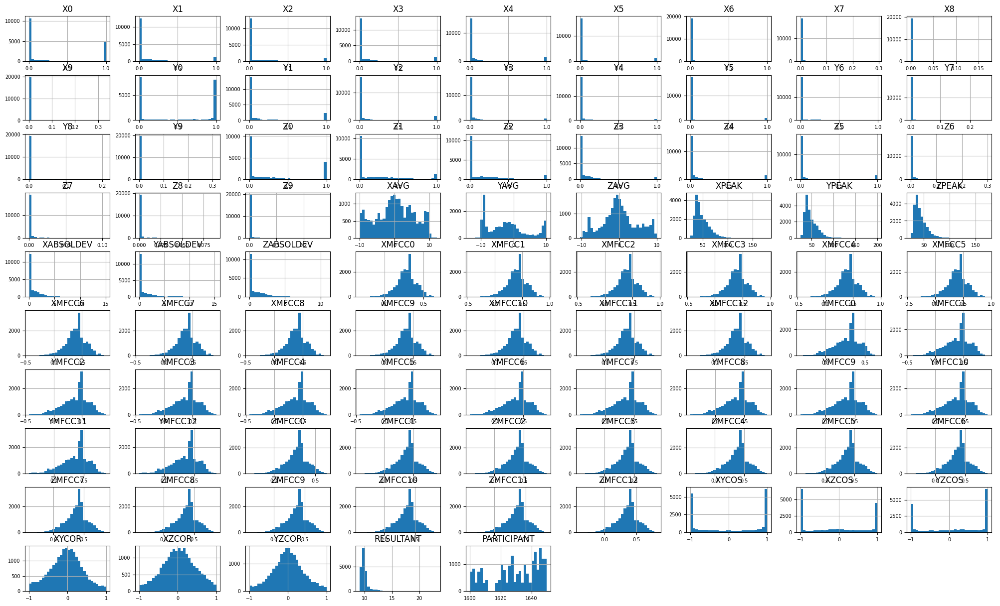

In [27]:
ax = all_phone_accel.hist(bins=30, figsize=(25, 15), xlabelsize = 7, ylabelsize = 7)

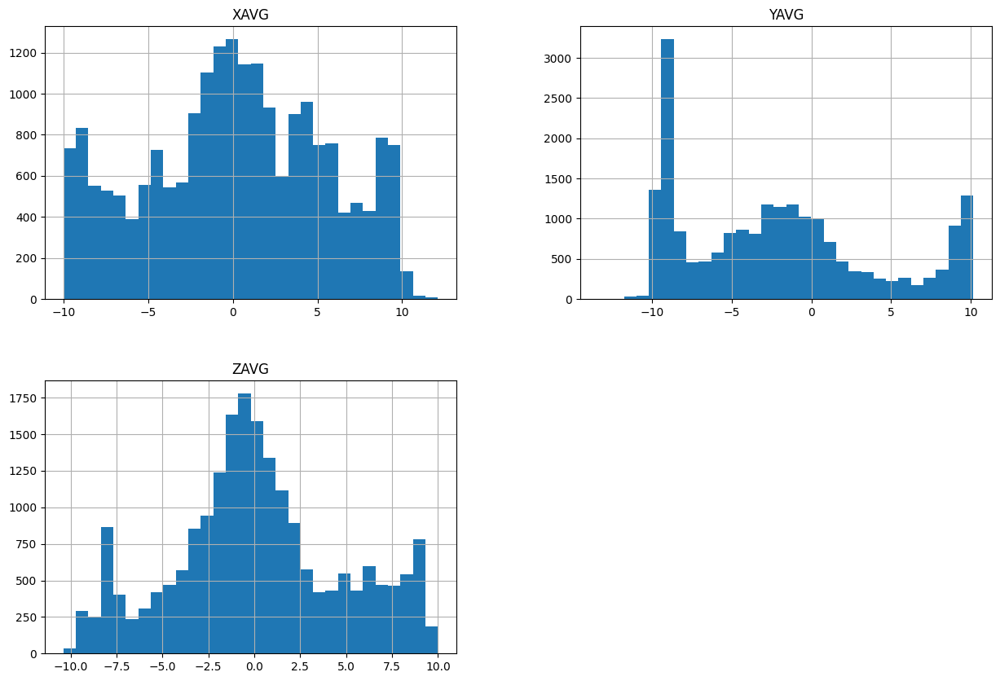

In [28]:
_ = all_phone_accel[['XAVG', 'YAVG', 'ZAVG']].hist(bins=30, figsize=(15, 10))

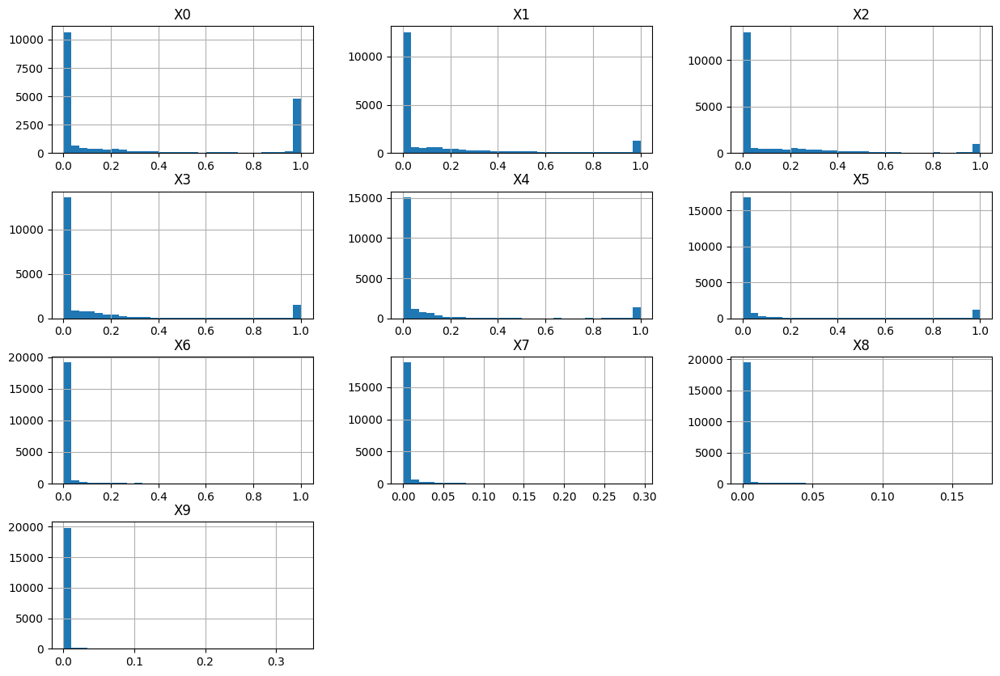

In [29]:
_ = all_phone_accel[['X0', 'X1', 'X2', 'X3','X4','X5','X6','X7','X8','X9']].hist(bins=30, figsize=(15, 10))

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\1635686219.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['XAVG'])


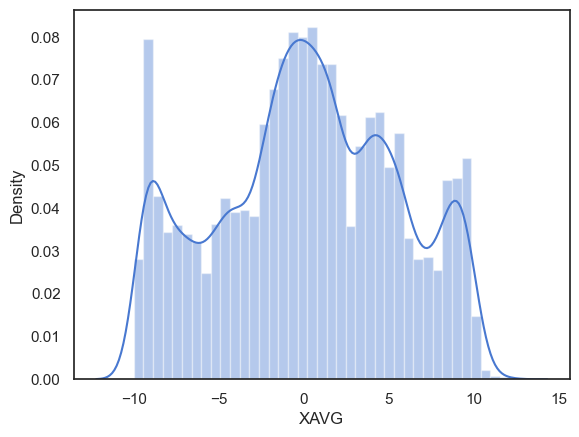

In [30]:
import seaborn as sns

sns.set(color_codes=True)
sns.set(style="white", palette="muted")
_ = sns.distplot(all_phone_accel['XAVG'])

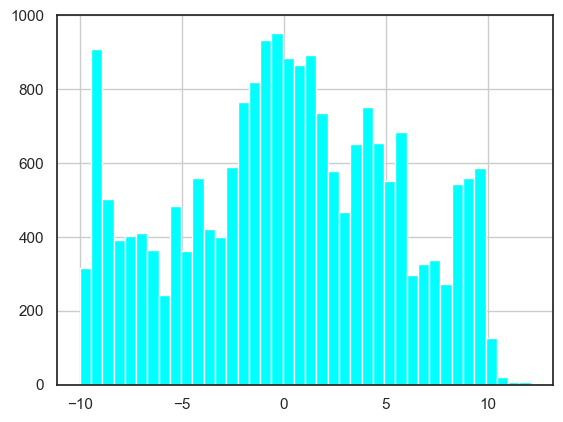

In [31]:

_ = all_phone_accel['XAVG'].hist(bins=40, color = 'cyan')

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\3909427808.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['YAVG'])


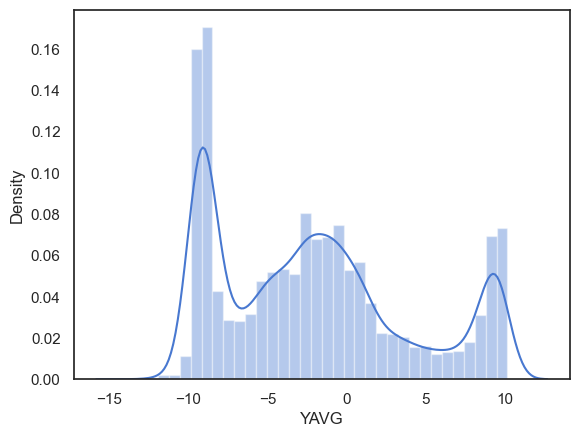

In [32]:
_ = sns.distplot(all_phone_accel['YAVG'])

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\3604163818.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['ZAVG'])


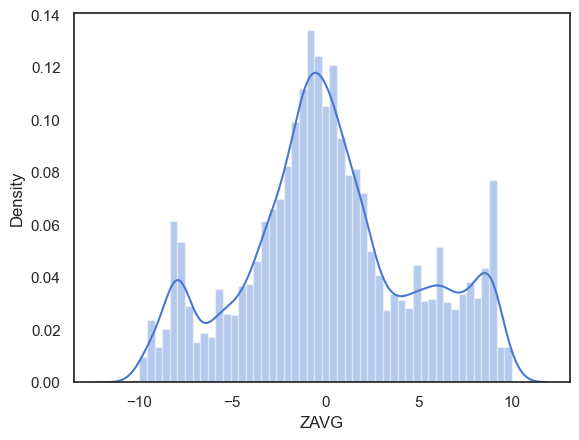

In [33]:
_ = sns.distplot(all_phone_accel['ZAVG'])

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\4128290335.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['XYCOR'])


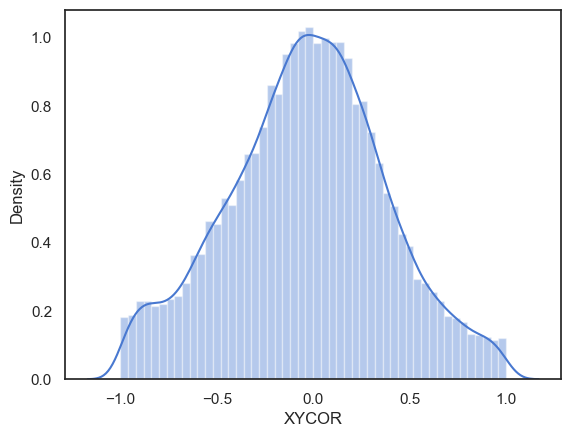

In [34]:
_ = sns.distplot(all_phone_accel['XYCOR'])

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\2490745790.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['XYCOS'])


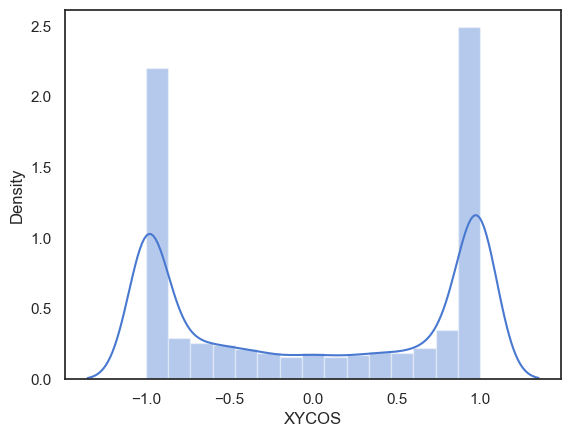

In [35]:
_ = sns.distplot(all_phone_accel['XYCOS'])

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\2946045803.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['RESULTANT'])


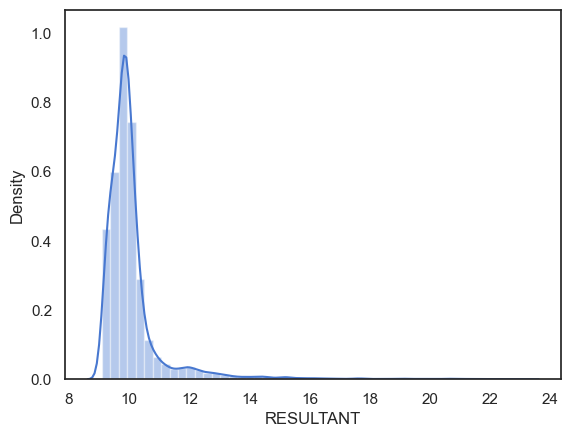

In [36]:
_ = sns.distplot(all_phone_accel['RESULTANT'])

C:\Users\Vaibhav Saxena\AppData\Local\Temp\ipykernel_24972\3330296450.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  _ = sns.distplot(all_phone_accel['YMFCC5'])


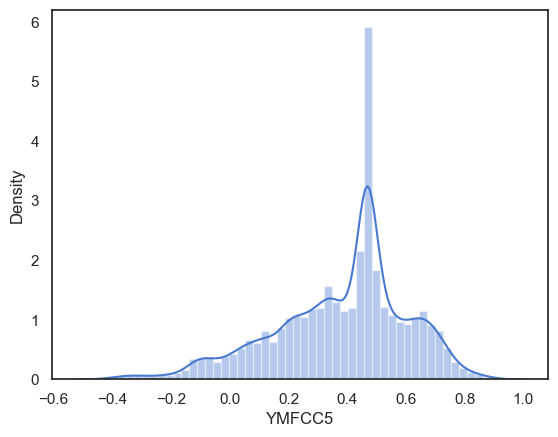

In [37]:
_ = sns.distplot(all_phone_accel['YMFCC5'])


Preprocessing of Input Dataset:
**Dropping the Participant column:**

The approach in this analysis will be to see all the participants as a closed united sample population. The purpose of this analysis is not to inquire the inter participant variability. Also, the participants number (44 in effect) is too small to significantly represent the variability of the general population.

Therefore, The participant column will be dropped:

In [38]:
all_phone_accel.drop('PARTICIPANT', axis = 1, inplace = True)


**Allocating the test subset:**

In [39]:
from sklearn.model_selection import train_test_split

y = all_phone_accel.ACTIVITY
X = all_phone_accel.drop('ACTIVITY', axis=1)

X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size = 0.75, 
                                                    test_size = 0.25,
                                                    shuffle = True, 
                                                    stratify = all_phone_accel.ACTIVITY)

In [40]:
X_train

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
15815,0.000,0.010,0.990,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.156447,0.154626,0.152639,-0.886972,-0.950481,0.838988,0.643061,-0.807571,-0.680011,9.28306
12238,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.137637,0.136034,0.134286,0.971964,-0.230877,-0.405929,-0.958659,0.788455,-0.743370,9.84579
14390,0.655,0.095,0.105,0.105,0.02,0.010,0.00,0.005,0.005,0.0,...,0.608298,0.601216,0.593491,-0.635102,-0.278143,-0.191868,-0.619915,-0.035456,-0.341885,13.22820
17528,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.471404,0.465916,0.459929,-0.526932,0.660157,-0.438570,-0.234843,0.581259,-0.264818,9.58161
1798,0.000,0.010,0.905,0.085,0.00,0.000,0.00,0.000,0.000,0.0,...,0.231631,0.228935,0.225993,0.942468,0.963312,0.970545,-0.112653,0.567141,-0.223673,9.59490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8876,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.423763,0.418830,0.413448,0.999747,0.999896,0.999831,-0.243747,-0.391475,-0.095925,10.33450
12198,0.000,0.000,0.000,1.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.033084,0.032698,0.032278,0.999945,0.994068,0.994468,-0.319027,-0.504306,-0.252668,9.60956
5609,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.267313,0.264201,0.260806,-0.919686,0.986515,-0.961028,0.953174,0.770711,0.742442,9.80116
7787,0.000,0.000,0.000,0.000,1.00,0.000,0.00,0.000,0.000,0.0,...,0.418788,0.413913,0.408594,-0.999915,-0.999986,0.999927,0.134063,0.018384,0.095662,10.07650


In [41]:
y_train

15815    S
12238    S
14390    B
17528    C
1798     O
        ..
8876     G
12198    Q
5609     H
7787     L
9788     M
Name: ACTIVITY, Length: 15487, dtype: object

In [42]:

X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
18047,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.287770,0.284420,0.280765,-0.901783,0.961623,-0.912654,0.150125,-0.661714,-0.329434,9.49740
9268,0.655,0.275,0.050,0.020,0.00,0.000,0.00,0.00,0.000,0.0,...,0.516507,0.510494,0.503934,-0.788507,0.781294,-0.653283,-0.351864,0.494523,0.015903,10.61350
16195,0.000,1.000,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,-0.030356,-0.030003,-0.029618,0.997644,0.989116,0.990053,-0.401569,0.125261,-0.276473,9.26901
7904,0.005,0.005,0.065,0.125,0.17,0.175,0.25,0.16,0.045,0.0,...,0.570262,0.563623,0.556380,-0.012144,-0.381415,0.186248,0.060330,0.024720,0.186953,10.47100
7795,0.000,0.000,0.010,0.000,0.99,0.000,0.00,0.00,0.000,0.0,...,0.426444,0.421479,0.416063,-0.925881,-0.999057,0.909924,0.977790,-0.984320,-0.986999,10.07420
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10964,0.240,0.410,0.340,0.010,0.00,0.000,0.00,0.00,0.000,0.0,...,0.541295,0.534994,0.528119,0.591358,-0.159010,-0.076228,0.433047,-0.203519,-0.319599,10.56740
8310,0.010,0.990,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.249534,0.246629,0.243459,0.996058,0.996677,0.998957,-0.424544,0.149299,0.022210,9.91879
19054,0.000,0.000,0.000,0.000,0.00,1.000,0.00,0.00,0.000,0.0,...,0.297965,0.294496,0.290712,-0.986051,0.998766,-0.985818,0.121779,-0.938175,-0.053748,9.95361
18345,0.000,0.000,0.000,1.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.421450,0.416544,0.411191,-0.998128,-0.999002,0.999315,0.472051,0.437265,-0.170447,10.17980


In [43]:
y_test

18047    O
9268     C
16195    I
7904     A
7795     M
        ..
10964    A
8310     J
19054    J
18345    F
11849    P
Name: ACTIVITY, Length: 5163, dtype: object

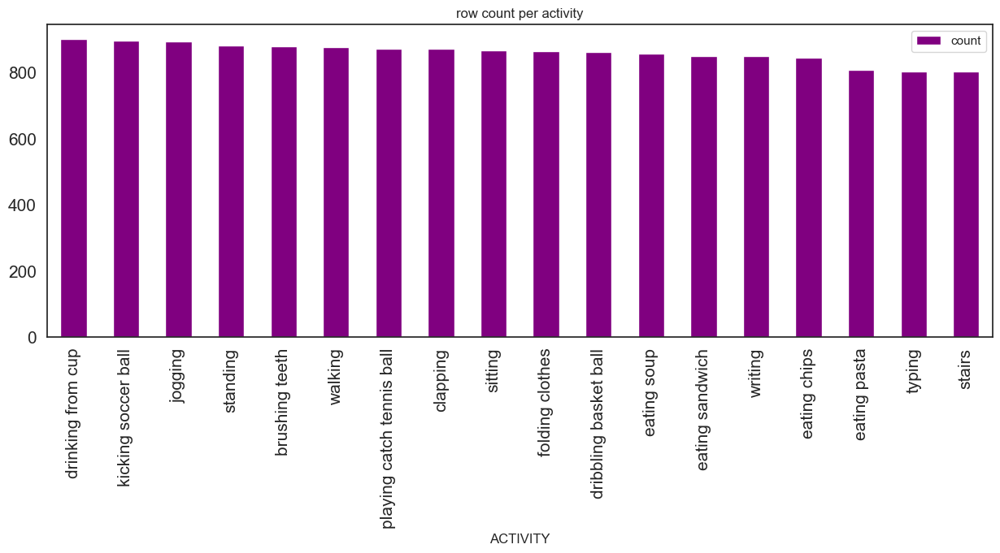

In [44]:
_ = y_train.map(activity_codes_mapping).value_counts().plot(kind = 'bar', figsize = (15,5), color = 'purple', title = 'row count per activity', legend = True, fontsize = 15)

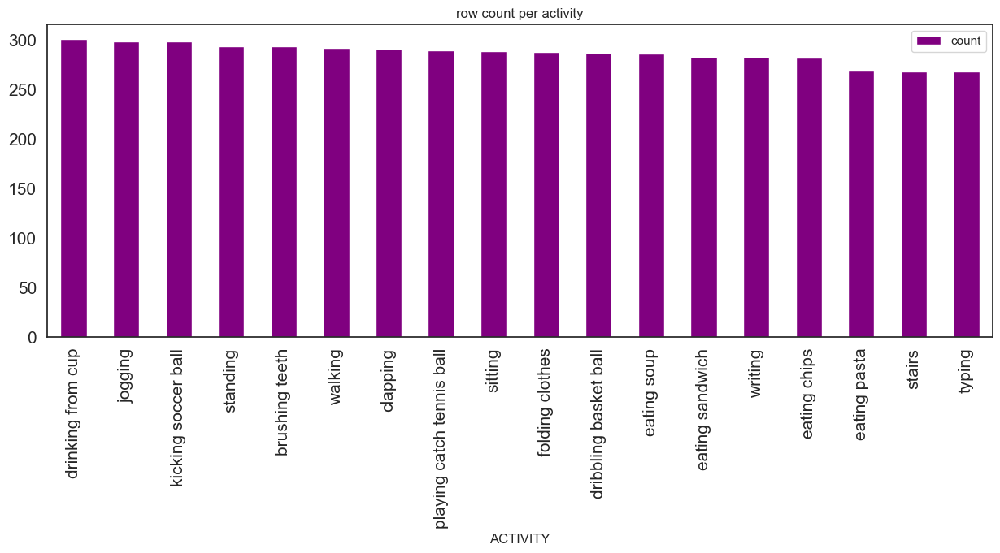

In [45]:
_ = y_test.map(activity_codes_mapping).value_counts().plot(kind = 'bar', figsize = (15,5), color = 'purple', title = 'row count per activity', legend = True, fontsize = 15)


Observation: both train and test class labels sets are fairly balanced

Temporarily re-unite the train lables to train dataset for further preprocessing steps.

In [46]:
X_train.insert(0, 'Y', y_train)

In [47]:

X_train

,Y,X0,X1,X2,X3,X4,X5,X6,X7,X8,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
15815,S,0.000,0.010,0.990,0.000,0.00,0.000,0.00,0.000,0.000,...,0.156447,0.154626,0.152639,-0.886972,-0.950481,0.838988,0.643061,-0.807571,-0.680011,9.28306
12238,S,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,...,0.137637,0.136034,0.134286,0.971964,-0.230877,-0.405929,-0.958659,0.788455,-0.743370,9.84579
14390,B,0.655,0.095,0.105,0.105,0.02,0.010,0.00,0.005,0.005,...,0.608298,0.601216,0.593491,-0.635102,-0.278143,-0.191868,-0.619915,-0.035456,-0.341885,13.22820
17528,C,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,...,0.471404,0.465916,0.459929,-0.526932,0.660157,-0.438570,-0.234843,0.581259,-0.264818,9.58161
1798,O,0.000,0.010,0.905,0.085,0.00,0.000,0.00,0.000,0.000,...,0.231631,0.228935,0.225993,0.942468,0.963312,0.970545,-0.112653,0.567141,-0.223673,9.59490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8876,G,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,...,0.423763,0.418830,0.413448,0.999747,0.999896,0.999831,-0.243747,-0.391475,-0.095925,10.33450
12198,Q,0.000,0.000,0.000,1.000,0.00,0.000,0.00,0.000,0.000,...,0.033084,0.032698,0.032278,0.999945,0.994068,0.994468,-0.319027,-0.504306,-0.252668,9.60956
5609,H,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,...,0.267313,0.264201,0.260806,-0.919686,0.986515,-0.961028,0.953174,0.770711,0.742442,9.80116
7787,L,0.000,0.000,0.000,0.000,1.00,0.000,0.00,0.000,0.000,...,0.418788,0.413913,0.408594,-0.999915,-0.999986,0.999927,0.134063,0.018384,0.095662,10.07650



**Outliers detection: in XPEAK, YPEAK, ZPEAK by inspection of the histogram/boxplot:**

From histograms inspection it seems that there are few extreme values in the PEAK related features, so, they will be removed:

In [48]:
upper_threshold_XPEAK = X_train.XPEAK.mean() + 9*X_train.XPEAK.std()
upper_threshold_XPEAK

176.60388332379495

In [49]:
X_train.XPEAK.max()

179.0

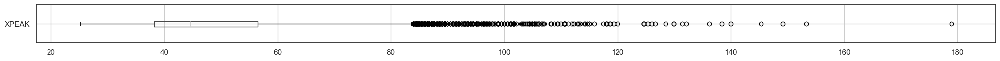

In [50]:
_ = X_train.boxplot(column=['XPEAK'], figsize=[25,1], vert=False)

In [51]:
X_train = X_train[X_train.XPEAK < upper_threshold_XPEAK].copy()

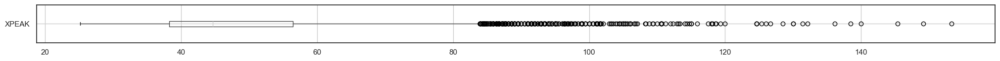

In [52]:
_ = X_train.boxplot(column=['XPEAK'], figsize=[25,1], vert=False)

In [53]:
upper_threshold_YPEAK = X_train.YPEAK.mean() + 9*X_train.YPEAK.std()
upper_threshold_YPEAK

185.3430383042717

In [54]:
X_train.YPEAK.max()

200.0

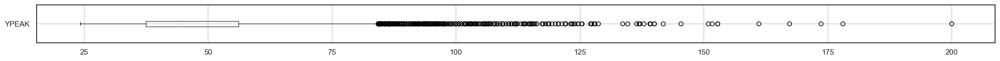

In [55]:
_ = X_train.boxplot(column=['YPEAK'], figsize=[25,1], vert=False)

In [56]:
X_train = X_train[X_train.YPEAK < upper_threshold_YPEAK].copy()

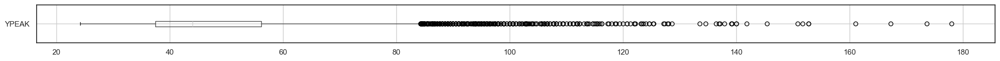

In [57]:
_ = X_train.boxplot(column=['YPEAK'], figsize=[25,1], vert=False)


ZPEAK

In [58]:
upper_threshold_ZPEAK = X_train.ZPEAK.mean() + 9*X_train.ZPEAK.std()
upper_threshold_ZPEAK

151.00659238331988

In [59]:
X_train.ZPEAK.max()

173.0

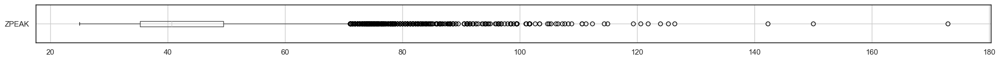

In [60]:
_ = X_train.boxplot(column=['ZPEAK'], figsize=[25,1], vert=False)


In [61]:
X_train = X_train[X_train.ZPEAK < upper_threshold_ZPEAK].copy()

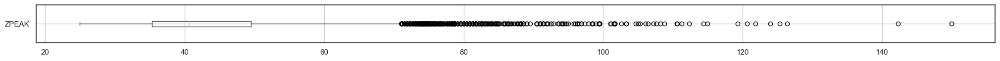

In [62]:
_ = X_train.boxplot(column=['ZPEAK'], figsize=[25,1], vert=False)





Now, let's separate out again y_train:

In [63]:

y_train = X_train['Y']

In [64]:
y_train

15815    S
12238    S
14390    B
17528    C
1798     O
        ..
8876     G
12198    Q
5609     H
7787     L
9788     M
Name: Y, Length: 15484, dtype: object

In [65]:
X_train.drop(['Y'], axis = 1, inplace = True)


Scaling:
rescaling will now be applied to the features that their absolute values exceed the range of ~1

In [66]:
from sklearn.preprocessing import MaxAbsScaler

scaling_transformer = MaxAbsScaler().fit(X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [67]:
X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']] = scaling_transformer.transform(X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])


Applying this scaling on the test set as well:

In [68]:
X_test = X_test.copy()

In [69]:
X_test[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']] = scaling_transformer.transform(X_test[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [70]:
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
18047,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.287770,0.284420,0.280765,-0.901783,0.961623,-0.912654,0.150125,-0.661714,-0.329434,0.412744
9268,0.655,0.275,0.050,0.020,0.00,0.000,0.00,0.00,0.000,0.0,...,0.516507,0.510494,0.503934,-0.788507,0.781294,-0.653283,-0.351864,0.494523,0.015903,0.461248
16195,0.000,1.000,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,-0.030356,-0.030003,-0.029618,0.997644,0.989116,0.990053,-0.401569,0.125261,-0.276473,0.402818
7904,0.005,0.005,0.065,0.125,0.17,0.175,0.25,0.16,0.045,0.0,...,0.570262,0.563623,0.556380,-0.012144,-0.381415,0.186248,0.060330,0.024720,0.186953,0.455055
7795,0.000,0.000,0.010,0.000,0.99,0.000,0.00,0.00,0.000,0.0,...,0.426444,0.421479,0.416063,-0.925881,-0.999057,0.909924,0.977790,-0.984320,-0.986999,0.437811
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10964,0.240,0.410,0.340,0.010,0.00,0.000,0.00,0.00,0.000,0.0,...,0.541295,0.534994,0.528119,0.591358,-0.159010,-0.076228,0.433047,-0.203519,-0.319599,0.459245
8310,0.010,0.990,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.249534,0.246629,0.243459,0.996058,0.996677,0.998957,-0.424544,0.149299,0.022210,0.431057
19054,0.000,0.000,0.000,0.000,0.00,1.000,0.00,0.00,0.000,0.0,...,0.297965,0.294496,0.290712,-0.986051,0.998766,-0.985818,0.121779,-0.938175,-0.053748,0.432570
18345,0.000,0.000,0.000,1.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.421450,0.416544,0.411191,-0.998128,-0.999002,0.999315,0.472051,0.437265,-0.170447,0.442400



resetting the indices:

In [71]:
X_train.reset_index(drop = True, inplace = True)
X_train

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
0,0.000,0.010,0.990,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.156447,0.154626,0.152639,-0.886972,-0.950481,0.838988,0.643061,-0.807571,-0.680011,0.403429
1,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.137637,0.136034,0.134286,0.971964,-0.230877,-0.405929,-0.958659,0.788455,-0.743370,0.427884
2,0.655,0.095,0.105,0.105,0.02,0.010,0.00,0.005,0.005,0.0,...,0.608298,0.601216,0.593491,-0.635102,-0.278143,-0.191868,-0.619915,-0.035456,-0.341885,0.574879
3,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.471404,0.465916,0.459929,-0.526932,0.660157,-0.438570,-0.234843,0.581259,-0.264818,0.416403
4,0.000,0.010,0.905,0.085,0.00,0.000,0.00,0.000,0.000,0.0,...,0.231631,0.228935,0.225993,0.942468,0.963312,0.970545,-0.112653,0.567141,-0.223673,0.416981
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15479,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.423763,0.418830,0.413448,0.999747,0.999896,0.999831,-0.243747,-0.391475,-0.095925,0.449123
15480,0.000,0.000,0.000,1.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.033084,0.032698,0.032278,0.999945,0.994068,0.994468,-0.319027,-0.504306,-0.252668,0.417618
15481,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.000,0.000,0.0,...,0.267313,0.264201,0.260806,-0.919686,0.986515,-0.961028,0.953174,0.770711,0.742442,0.425945
15482,0.000,0.000,0.000,0.000,1.00,0.000,0.00,0.000,0.000,0.0,...,0.418788,0.413913,0.408594,-0.999915,-0.999986,0.999927,0.134063,0.018384,0.095662,0.437911


In [72]:
X_test.reset_index(drop = True, inplace = True)
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
0,1.000,0.000,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.287770,0.284420,0.280765,-0.901783,0.961623,-0.912654,0.150125,-0.661714,-0.329434,0.412744
1,0.655,0.275,0.050,0.020,0.00,0.000,0.00,0.00,0.000,0.0,...,0.516507,0.510494,0.503934,-0.788507,0.781294,-0.653283,-0.351864,0.494523,0.015903,0.461248
2,0.000,1.000,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,-0.030356,-0.030003,-0.029618,0.997644,0.989116,0.990053,-0.401569,0.125261,-0.276473,0.402818
3,0.005,0.005,0.065,0.125,0.17,0.175,0.25,0.16,0.045,0.0,...,0.570262,0.563623,0.556380,-0.012144,-0.381415,0.186248,0.060330,0.024720,0.186953,0.455055
4,0.000,0.000,0.010,0.000,0.99,0.000,0.00,0.00,0.000,0.0,...,0.426444,0.421479,0.416063,-0.925881,-0.999057,0.909924,0.977790,-0.984320,-0.986999,0.437811
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5158,0.240,0.410,0.340,0.010,0.00,0.000,0.00,0.00,0.000,0.0,...,0.541295,0.534994,0.528119,0.591358,-0.159010,-0.076228,0.433047,-0.203519,-0.319599,0.459245
5159,0.010,0.990,0.000,0.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.249534,0.246629,0.243459,0.996058,0.996677,0.998957,-0.424544,0.149299,0.022210,0.431057
5160,0.000,0.000,0.000,0.000,0.00,1.000,0.00,0.00,0.000,0.0,...,0.297965,0.294496,0.290712,-0.986051,0.998766,-0.985818,0.121779,-0.938175,-0.053748,0.432570
5161,0.000,0.000,0.000,1.000,0.00,0.000,0.00,0.00,0.000,0.0,...,0.421450,0.416544,0.411191,-0.998128,-0.999002,0.999315,0.472051,0.437265,-0.170447,0.442400


In [73]:
y_train.reset_index(drop = True, inplace = True)
y_train

0        S
1        S
2        B
3        C
4        O
        ..
15479    G
15480    Q
15481    H
15482    L
15483    M
Name: Y, Length: 15484, dtype: object

In [74]:
y_test.reset_index(drop = True, inplace = True)
y_test

0       O
1       C
2       I
3       A
4       M
       ..
5158    A
5159    J
5160    J
5161    F
5162    P
Name: ACTIVITY, Length: 5163, dtype: object


Special visualization of triples of features clustering pattern
Owing to the fact that the features in the transformed dataset can, logically, be grouped in triples (corresponding to the X, Y, Z geometric axes), there is an opportunity to assess the capability of the features to separate the associated classes by visualization via a rotating perspective plot. (via plotly.express library)

**Comment**: the graph data for the *individual* example participants were fetched directly from the arff files and not taken fron the above processed dataframe all_phone_accel (for simplicity)





Example 1: Participant 23 phone accel Features: XAVG YAVG ZAVG

In [75]:
fn = r'DATA/signals/phone/accel/data_1623_accel_phone.arff'
par_23_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_23_df['ACT'] = par_23_df['ACTIVITY'].map(activity_codes_mapping)

In [76]:
import plotly.express as px

fig = px.scatter_3d(par_23_df, x='XAVG', y='YAVG', z='ZAVG', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()


Example 2: Participant 40 phone accel Features: XABSULTEV YABSULDEV ZABSULDEV

In [77]:
fn = r'DATA/signals/phone/accel/data_1640_accel_phone.arff'
par_40_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_40_df['ACT'] = par_40_df['ACTIVITY'].map(activity_codes_mapping)

In [78]:
import plotly.express as px

fig = px.scatter_3d(par_40_df, x='XABSOLDEV', y='YABSOLDEV', z='ZABSOLDEV', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

Example 3: Participant 35 phone accel Features: XMFCC7 YMFCC7 ZMFCC7

In [79]:
fn = r'DATA/signals/phone/accel/data_1640_accel_phone.arff'
par_40_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_40_df['ACT'] = par_40_df['ACTIVITY'].map(activity_codes_mapping)

In [80]:
import plotly.express as px

fig = px.scatter_3d(par_40_df, x='XABSOLDEV', y='YABSOLDEV', z='ZABSOLDEV', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()



Example 3: Participant 35 phone accel Features: XMFCC7 YMFCC7 ZMFCC7

In [81]:
fn = r'DATA/signals/phone/accel/data_1635_accel_phone.arff'
par_35_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_35_df['ACT'] = par_35_df['ACTIVITY'].map(activity_codes_mapping)

In [82]:
import plotly.express as px

fig = px.scatter_3d(par_35_df, x='XMFCC7', y='YMFCC7', z='ZMFCC7', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height = 1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()


Example 4: Participant 0 phone accel Features: X5 Y5 Z5

In [83]:
fn = r'DATA/signals/phone/accel/data_1640_accel_phone.arff'
par_0_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_0_df['ACT'] = par_0_df['ACTIVITY'].map(activity_codes_mapping)

In [84]:
import plotly.express as px

fig = px.scatter_3d(par_0_df, x='X5', y='Y5', z='Z5', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()


Example 5: Participant 0 phone accel Features: XAVG YAVG ZAVG

In [85]:

fig = px.scatter_3d(par_0_df, x='XAVG', y='YAVG', z='ZAVG', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

Example 6: All participants: phone accel features: XAVG YAVG ZAVG



In [86]:

all_pa = all_phone_accel.copy()
all_pa['ACT'] = all_pa['ACTIVITY'].map(activity_codes_mapping)

fig = px.scatter_3d(all_pa, x='XAVG', y='YAVG', z='ZAVG', color ='ACT', color_discrete_map = activity_color_map)
#fig = px.scatter_3d(all_pa, x='XABSOLDEV', y='YABSOLDEV', z='ZABSOLDEV', color ='ACT')
#fig = px.scatter_3d(all_pa, x='XYCOS', y='XZCOS', z='YZCOS', color ='ACTIVITY')
#fig = px.scatter_3d(all_pa, x='X9', y='Y9', z='Z9', color ='ACT', color_discrete_map = activity_color_map)
#fig = px.scatter_3d(all_pa, x='XYCOR', y='XZCOR', z='YZCOR', color ='ACTIVITY')

#fig = px.scatter_3d(all_pa, x='XMFCC7', y='YMFCC7', z='ZMFCC7', color ='ACTIVITY')

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    width=1800,
                    height = 1000,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()


Example 7: All participants: phone accel features: XMFCC7 YMFCC7 ZMFCC7

In [87]:
import plotly.express as px

fig = px.scatter_3d(all_pa, x='XMFCC7', y='YMFCC7', z='ZMFCC7', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    width=1800,
                    height = 1000,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )

fig.show()



Visualizing the clustering pattern via t-SNE algorithm (for individual participants)

In [88]:
from matplotlib import pyplot as plt
from sklearn.manifold import TSNE

def plot_tSNE(X, y, fig_size):
    tsne = TSNE(n_components=2, random_state=300)
    X_2d = tsne.fit_transform(X)
    target_ids = ('A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'O', 'P', 'Q', 'R', 'S' )

    plt.figure(figsize=(fig_size, fig_size))
    colors = 'lime', 'red', 'blue', 'orange', 'yellow', 'lightgreen', 'greenyellow', 'magenta', 'gold', 'cyan', 'purple', 'lightgreen', 'violet', 'limegreen', 'deepskyblue', 'mediumspringgreen', 'plum', 'olive'

    for i, c, label in zip(target_ids, colors, tuple(activity_codes_mapping.values())):
        plt.scatter(X_2d[y == i, 0], X_2d[y == i, 1], c=c, label=label)

    plt.legend()
    plt.show()



Participant 23: (1623)

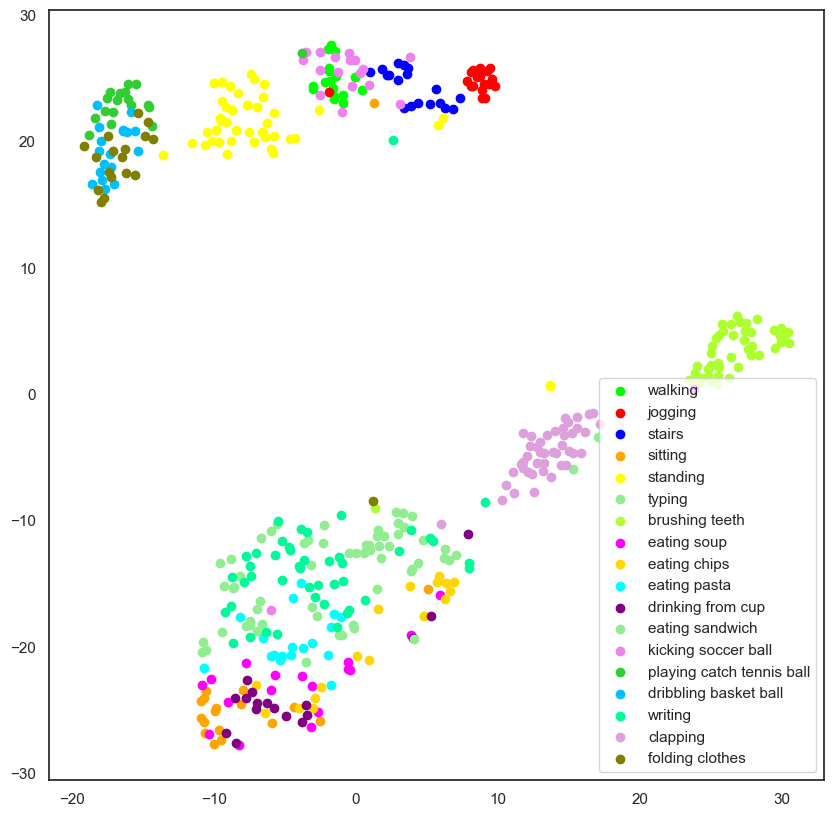

In [89]:
yy = par_23_df.ACTIVITY
XX = par_23_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1)
plot_tSNE(XX, yy, 10)


Participant 40: (1640)

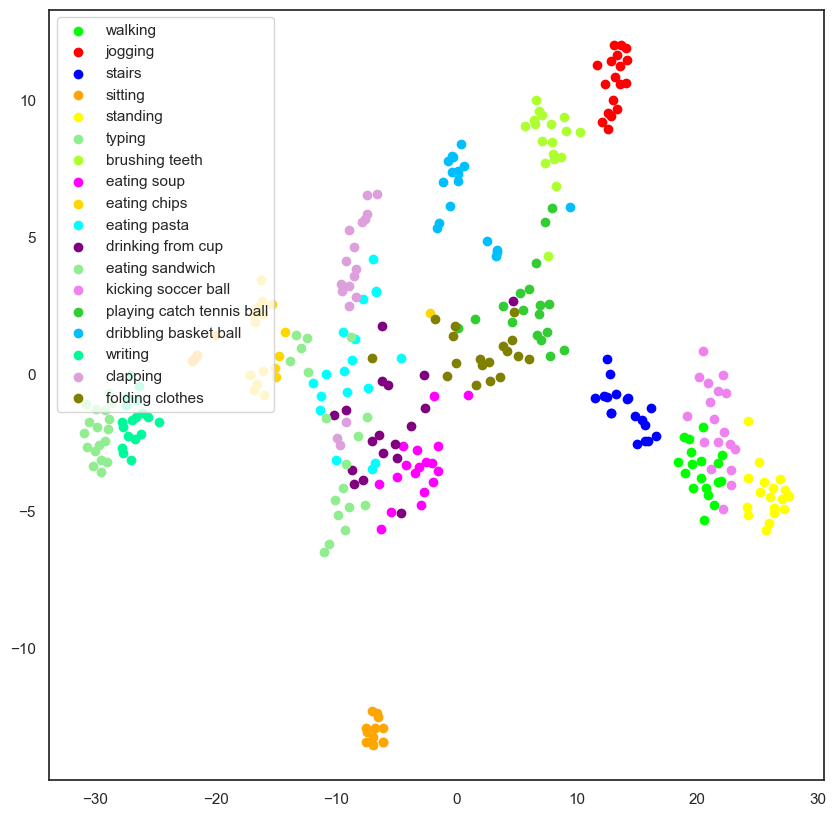

In [90]:

yy = par_40_df.ACTIVITY
XX = par_40_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1)
plot_tSNE(XX, yy, 10)

Participant 35: (1635)</size>

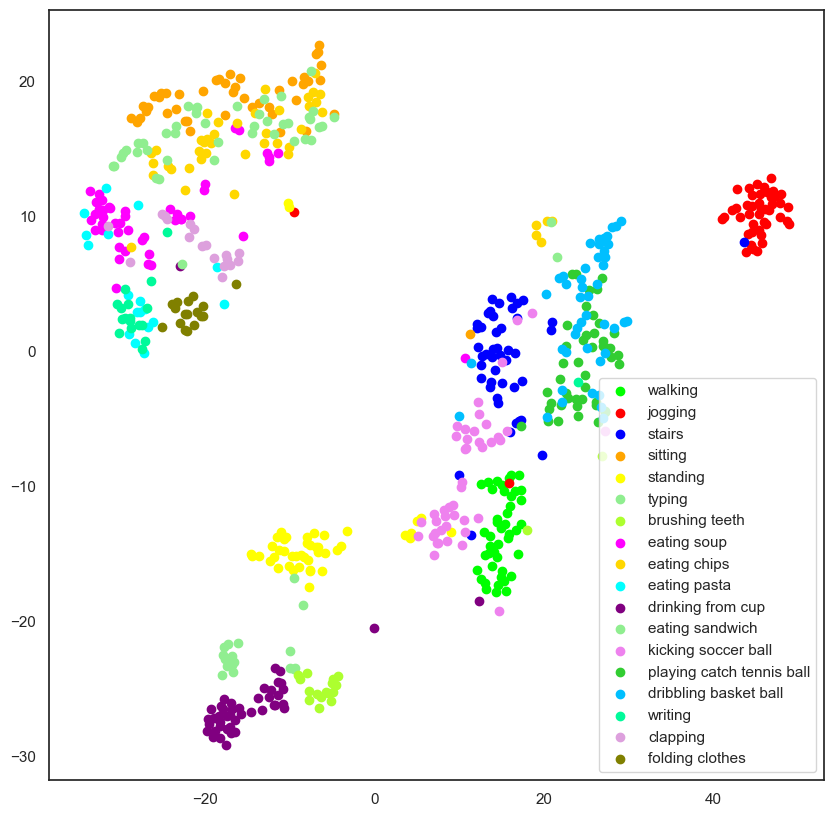

In [91]:
yy = par_35_df.ACTIVITY
XX = par_35_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1)
plot_tSNE(XX, yy, 10)


Participant 0: (1600)



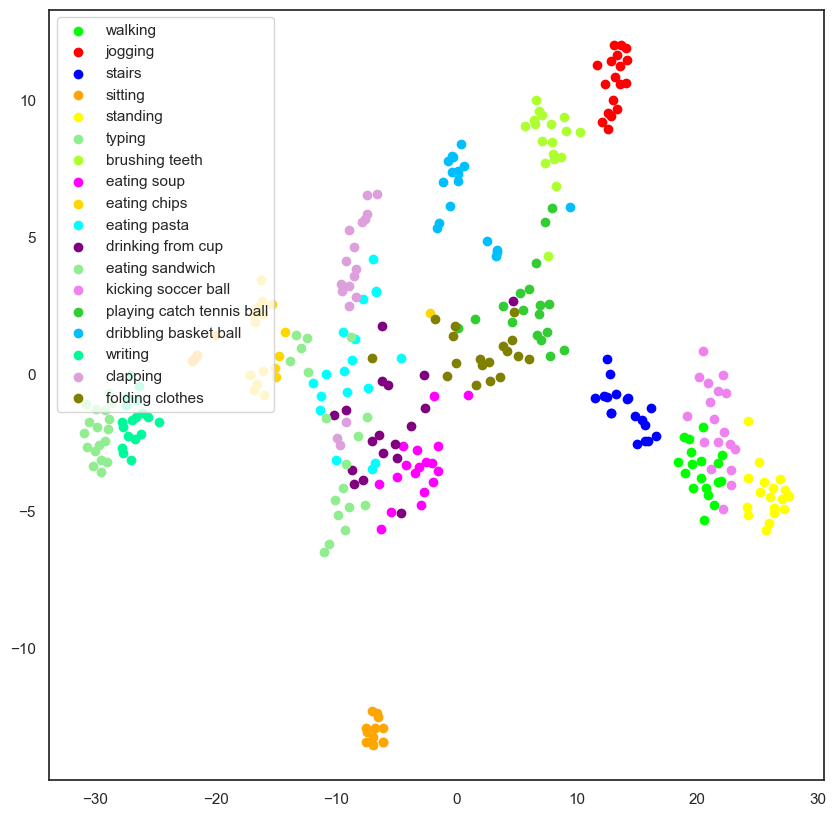

In [92]:
yy = par_0_df.ACTIVITY
XX = par_0_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1)
plot_tSNE(XX, yy, 10)

In [94]:
import six
import sys
sys.modules['sklearn.externals.six'] = six


In [95]:
# For the tree visualization
import pydot
from IPython.display import Image
from sklearn.externals.six import StringIO
from sklearn.tree import export_graphviz

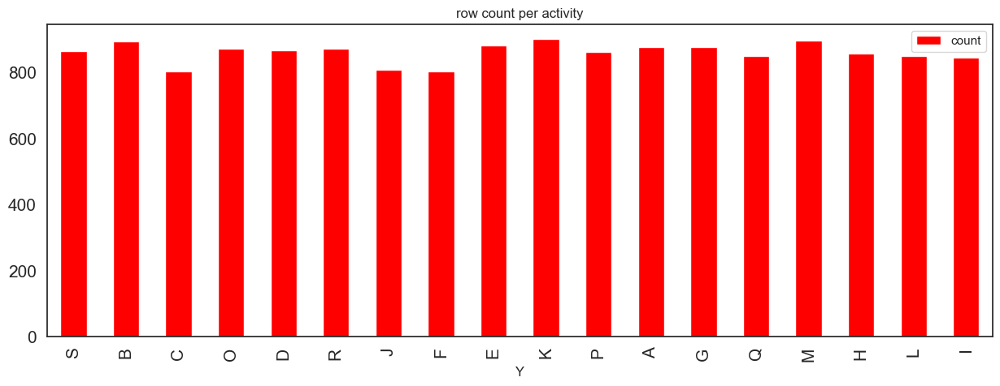

In [96]:
_ = y_train.value_counts(sort = False).plot(kind = 'bar', figsize = (15,5), color = 'red', title = 'row count per activity', legend = True, fontsize = 15)

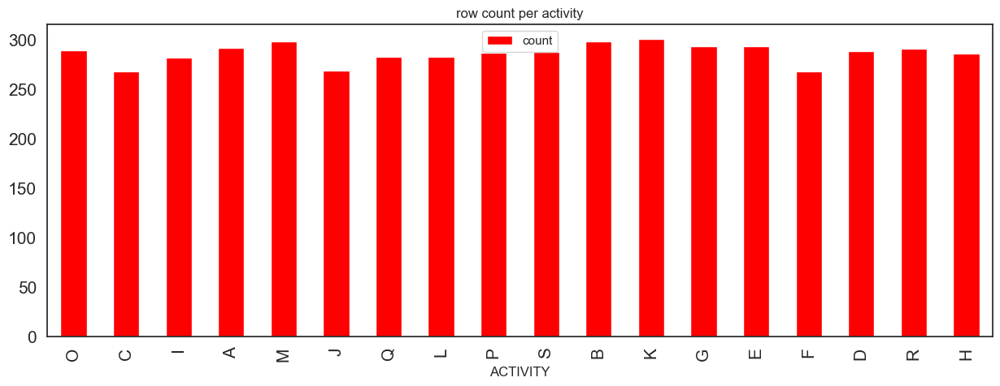

In [97]:
_ = y_test.value_counts(sort = False).plot(kind = 'bar', figsize = (15,5), color = 'red', title = 'row count per activity', legend = True, fontsize = 15)


Observation: both test and train series seem adequately balanced, pertaining the Activity labels representation



## Models mean prediction accuracy scores summary

Decision Tree: 0.33

Random Forest: 0.44

Logistic Regression: 0.38

KNN: 0.77

## Insights & Conclusions:

1) The K Nearest Neighbor classifier has prooved to provide substantial higher prediction accuracy than the rest of the models (overall mean accuracy ~0.77 on test set) in this case.

2) The analysis demonstrated typical differentiation of detection accuracy accross the various physical activities:

The highest detection accuracy is for Jogging: ~0.95 walking, stairs, kicking soccer ball, dribbling basket ball also have high accuracies: ~0.8 On the other hand, the eating related activities have lower detection accuracies: ~0.6 However, this lower accuracy is still surprisingly significant ! (10 times the neutral guess accuracy, 1/18), considering the fact that the smartphone was placed inside the participant's pants leg pocket !

3) The accuracy profiles are consistent with the visual clustering patterns seen in the three dimentional features visualization plots & t-SNE, in particular, the jogging points clusters where exceptionally noticable and distinct.

4) Possible explanations of the above observations:

The Jogging etc. where highly predictable because they where the most intense and strongly related to leg movement (the phone was inside the leg pocket)

The suprisingly significant accuracy rates of identifying eatings activites by the phone might be explained by the posture sitting changes characterizing such activities:

The fact that the accelerometer measures also the gravity vector, could supply additional implied information pertaining the orientation of the device and, therefore, as to the posture mode (standing/sitting) of the participant, which could contribute to the accuracy detection ability.